# Create mask of reduced timestep forecasts

In [1]:
import glob
import cftime
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

fs = 12
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15, 10)
matplotlib.rcParams['font.size'] = fs

In [2]:
paths = sorted(glob.glob('/g/data/xv83/dcfp/CAFE-f6/c5-d60-pX-f6-*/ocean_scalar_month.zarr.zip'))

In [3]:
def open_template(path):
    da = 1800+0*xr.open_zarr(
        path, consolidated=True).squeeze()['temp_total'].isel(
        time=0).rename(
        {'time':'init_date'}).drop(
        ['average_DT','average_T1','average_T2','scalar_axis'])
    da.attrs = {'long_name': 'CAFE-f6 forecast timesteps'}
    return da.rename('CAFE-f6_timesteps')

def open_forecast(path):
    da = xr.open_zarr(
        path, consolidated=True).squeeze()['temp_total'].drop(
        ['average_DT','average_T1','average_T2','scalar_axis'])
    da = da.expand_dims({'init_date': [da.time[0].item()]})
    da = da.assign_coords({'time': range(len(da.time))})
    return da.rename({'time': 'lead_time'})

In [4]:
template = xr.concat([open_template(path) for path in paths], dim='init_date').compute()
heat = xr.concat([open_forecast(path) for path in paths], dim='init_date').compute()

In [5]:
def update_template(template, fcst, mems, tss):
    template = template.copy()
    for mem, ts in zip(mems, tss):
        template = xr.where((template.init_date==fcst) & (template.ensemble==mem), ts, template)
    return template

In [6]:
def plot_forecast(var, fcst, mems, tss):
    for e in var.ensemble.values:
        plt.plot(var.lead_time, var.sel(init_date=fcst, ensemble=e), 
                 color='k', linewidth=1)
    for e in mems:
        plt.plot(var.lead_time, var.sel(init_date=fcst, ensemble=e), 
                 color='r', linewidth=1.5, linestyle='--')

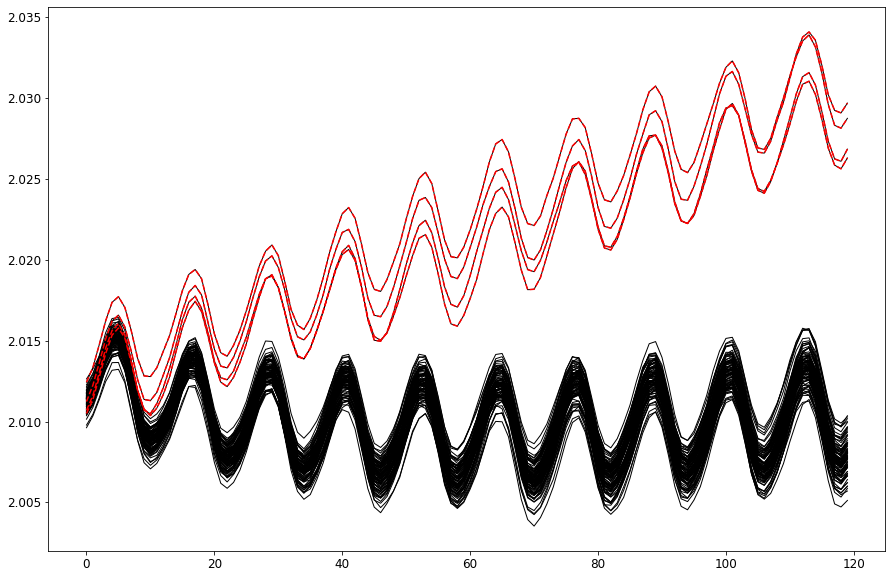

In [7]:
fcst = cftime.DatetimeJulian(2020, 11, 16)
mems = [27, 37, 51, 76]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

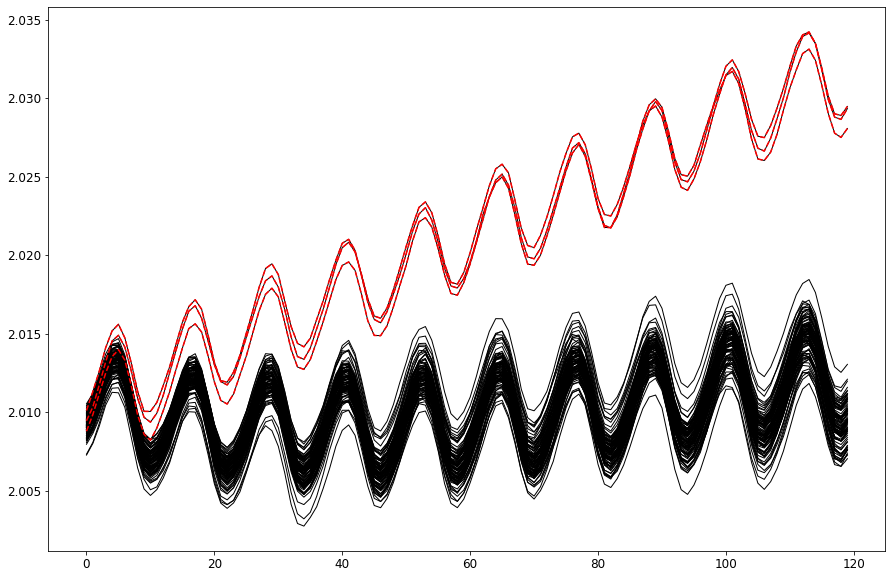

In [8]:
fcst = cftime.DatetimeJulian(2019, 11, 16)
mems = [44, 48, 81]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

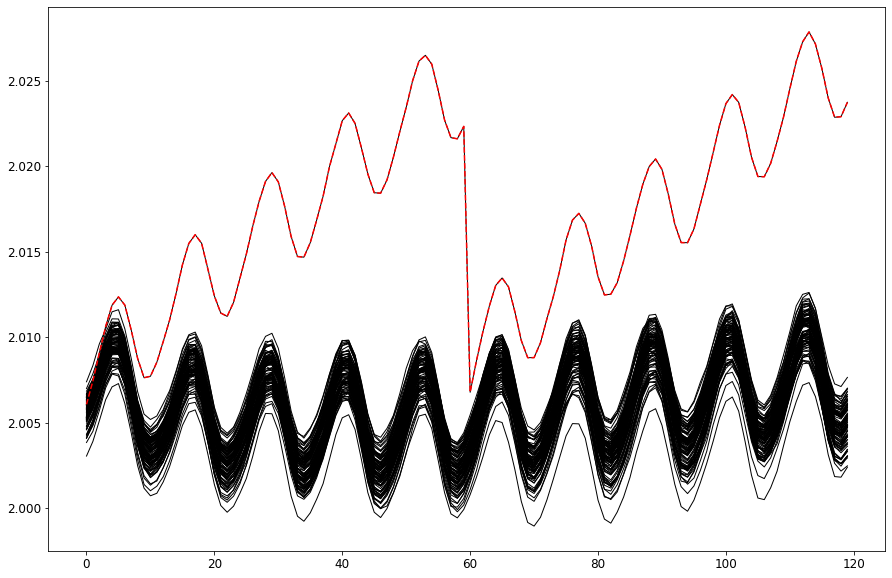

In [9]:
fcst = cftime.DatetimeJulian(2018, 11, 16)
mems = [61]
tss = [900]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

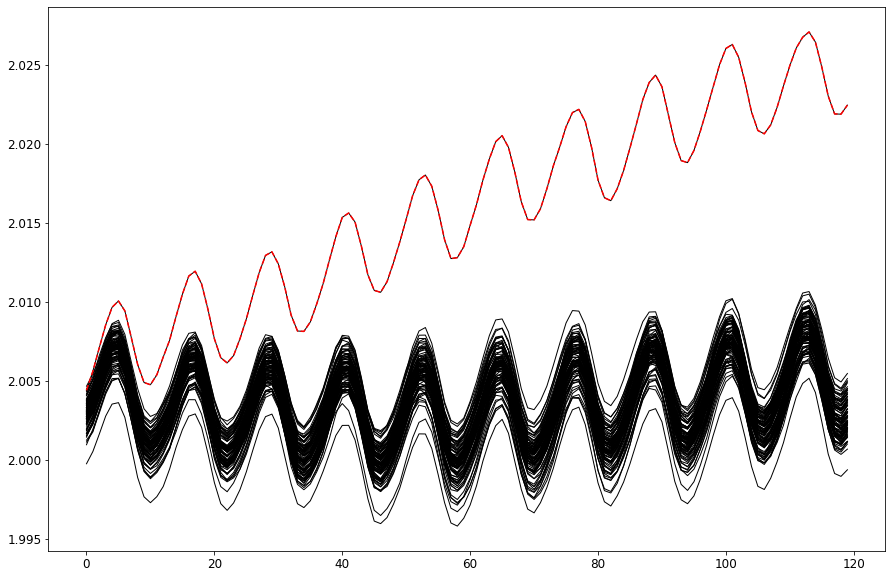

In [10]:
fcst = cftime.DatetimeJulian(2017, 11, 16)
mems = [92]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

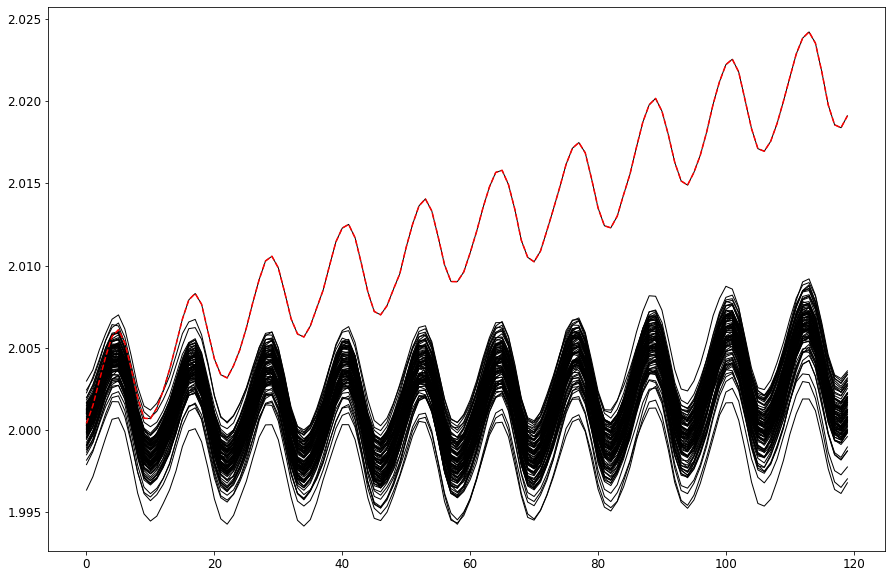

In [11]:
fcst = cftime.DatetimeJulian(2016, 11, 16)
mems = [49]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

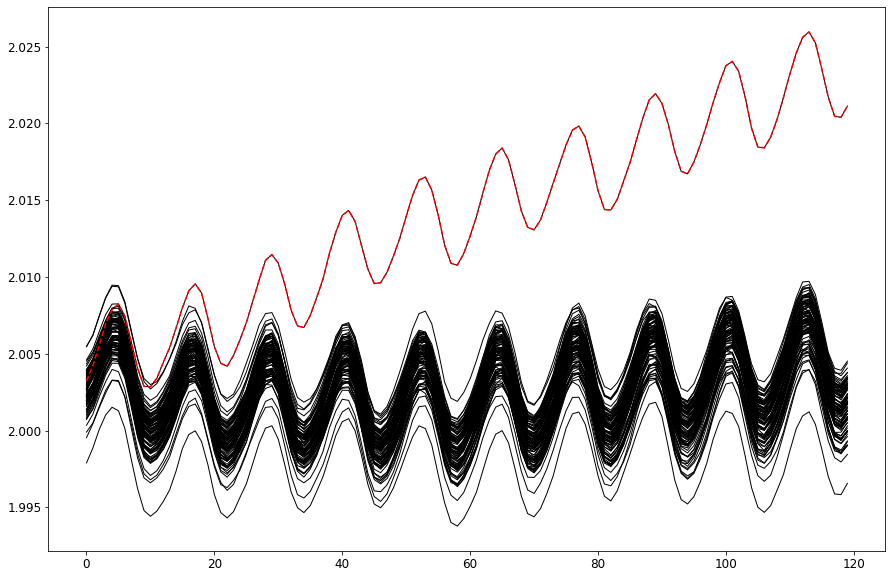

In [12]:
fcst = cftime.DatetimeJulian(2015, 11, 16)
mems = [48]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

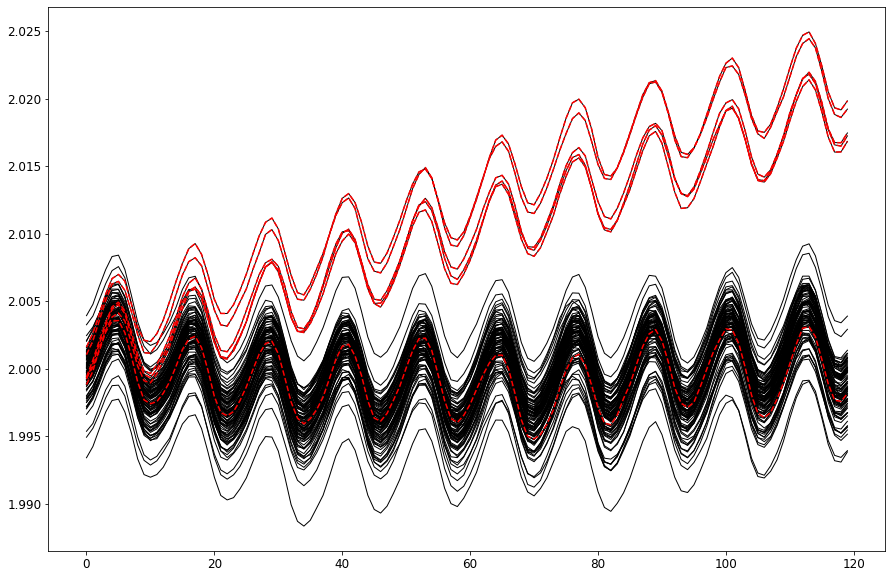

In [13]:
fcst = cftime.DatetimeJulian(2014, 11, 16)
mems = [3, 9, 18, 42, 55, 89]
tss = [1200, 1200, 1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

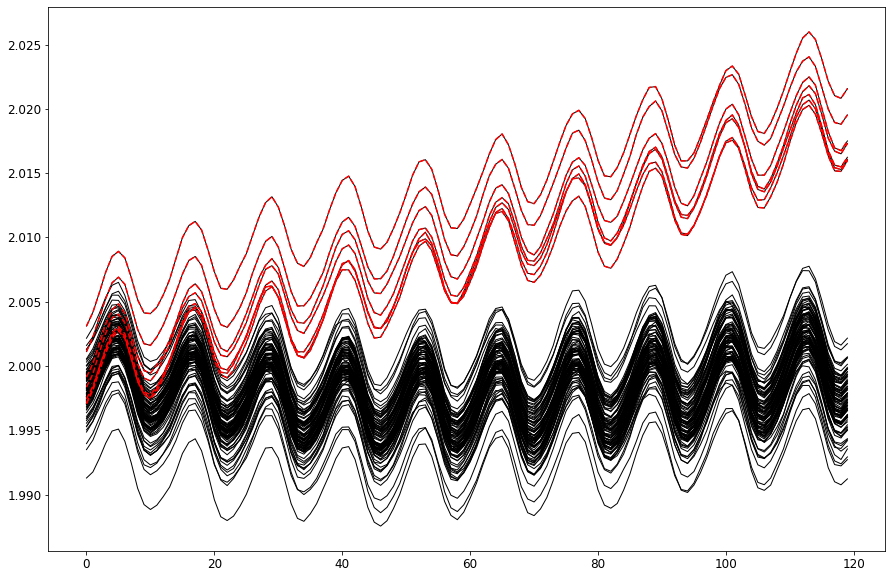

In [14]:
fcst = cftime.DatetimeJulian(2013, 11, 16)
mems = [5, 35, 47, 58, 74, 78, 88]
tss = [1200, 1200, 1200, 1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

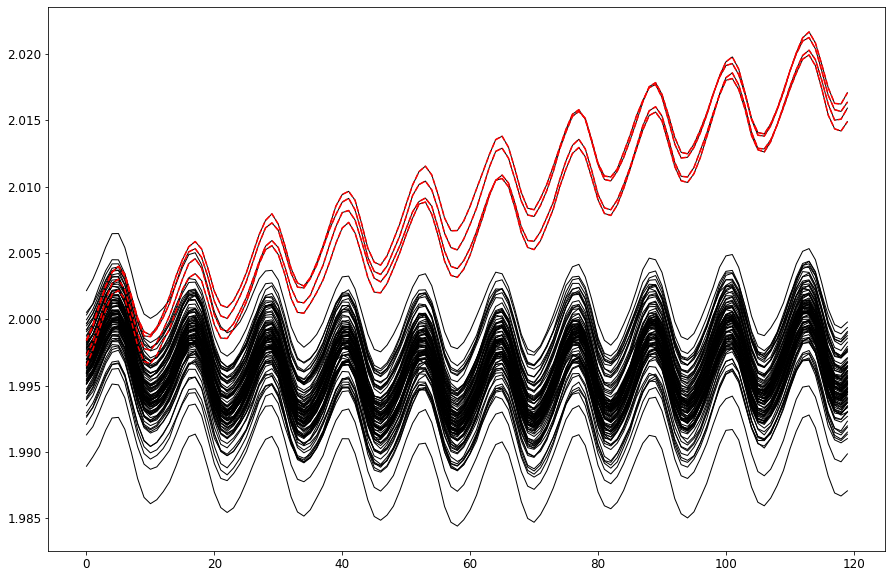

In [15]:
fcst = cftime.DatetimeJulian(2012, 11, 16)
mems = [23, 38, 40, 51]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

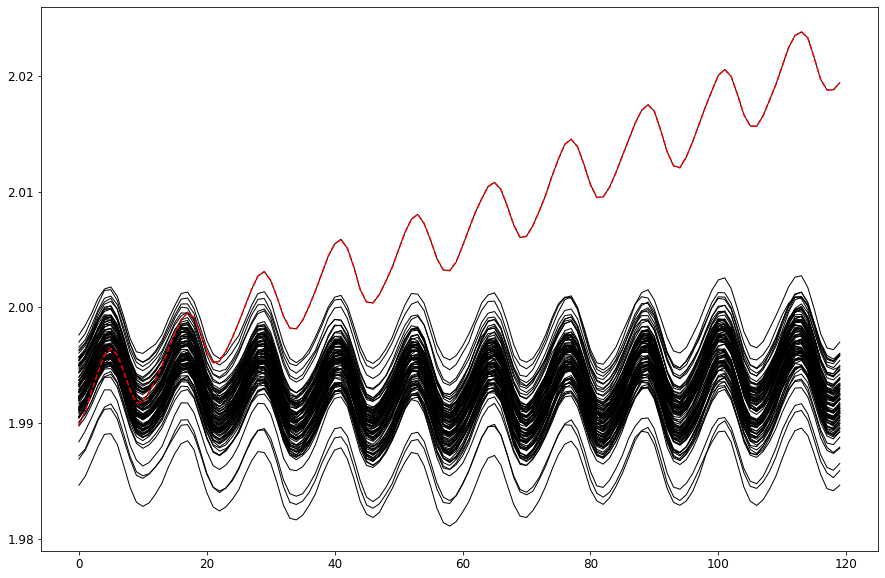

In [16]:
fcst = cftime.DatetimeJulian(2011, 11, 16)
mems = [7]
tss = [900]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

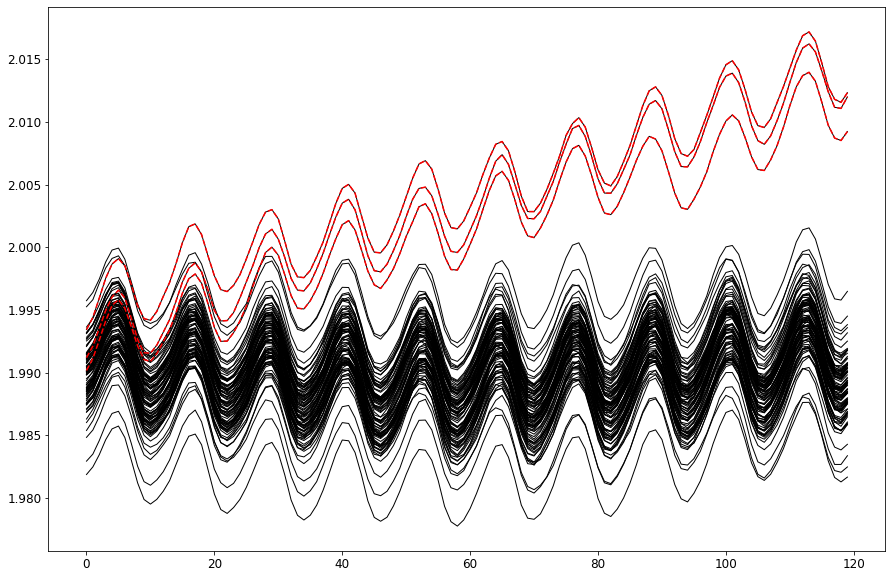

In [17]:
fcst = cftime.DatetimeJulian(2010, 11, 16)
mems = [20, 35, 48]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

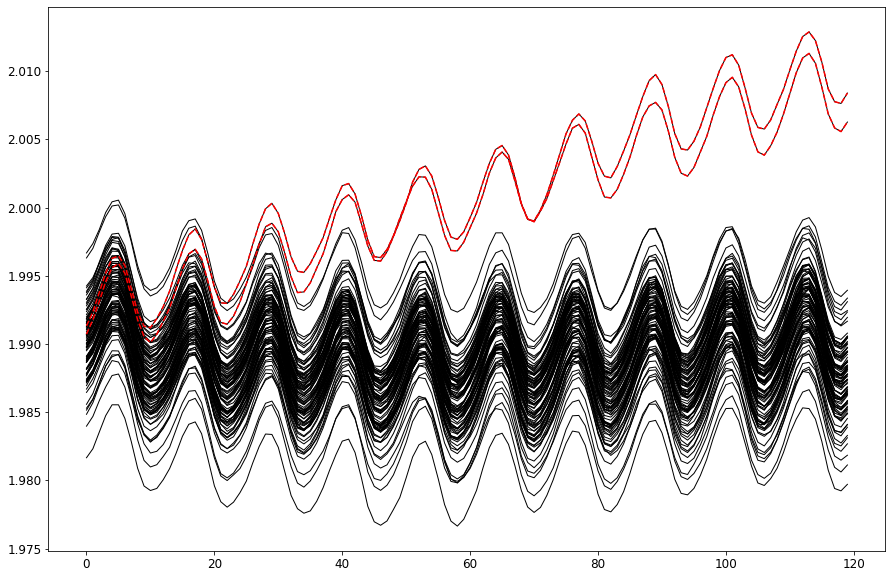

In [18]:
fcst = cftime.DatetimeJulian(2009, 11, 16)
mems = [34, 71]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

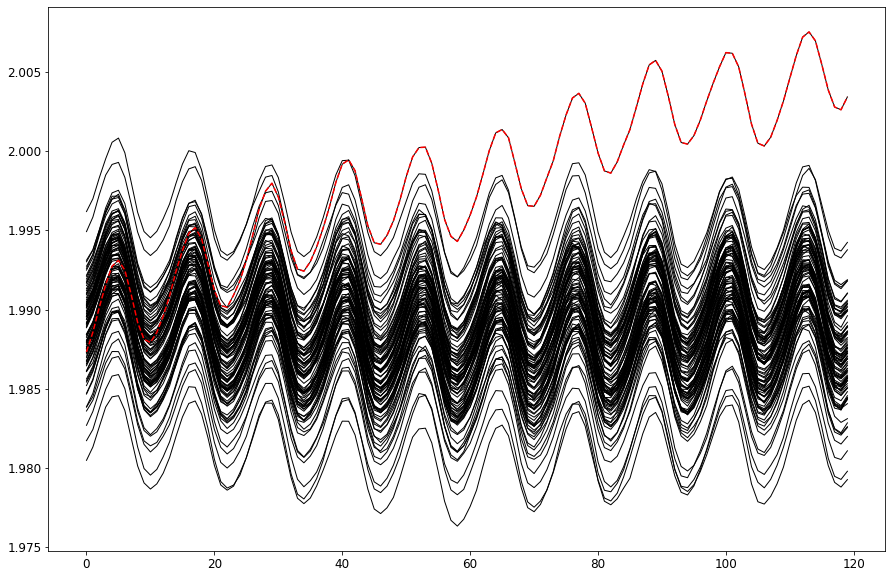

In [19]:
fcst = cftime.DatetimeJulian(2008, 11, 16)
mems = [15]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

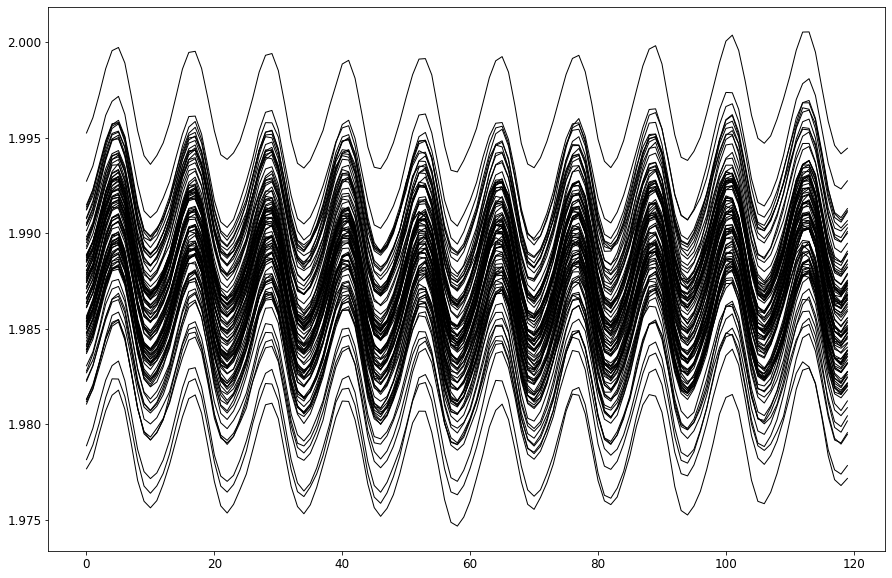

In [20]:
fcst = cftime.DatetimeJulian(2007, 11, 16)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

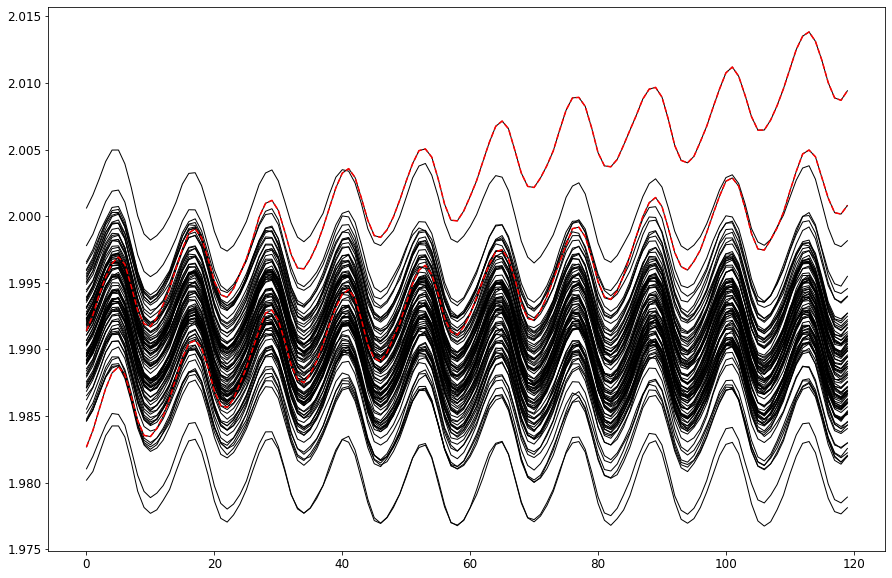

In [21]:
fcst = cftime.DatetimeJulian(2006, 11, 16)
mems = [27, 33]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

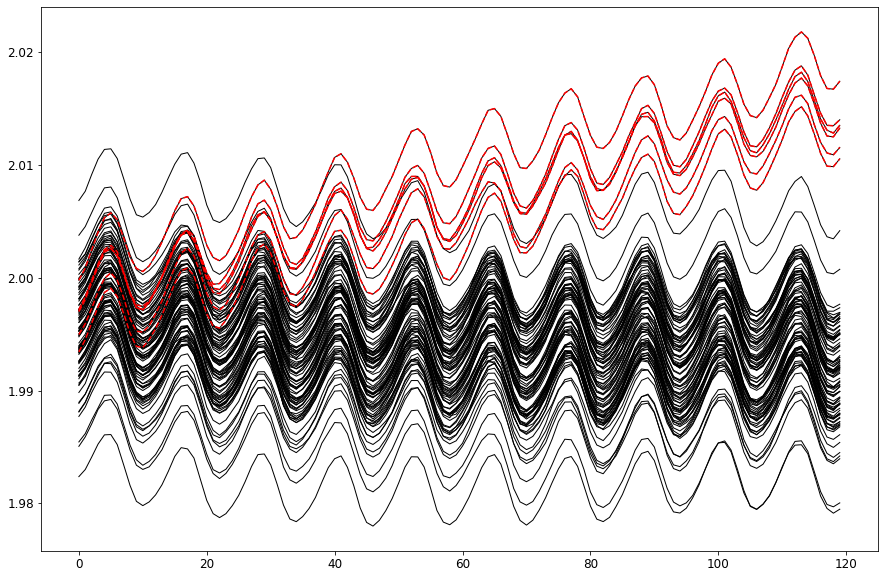

In [22]:
fcst = cftime.DatetimeJulian(2005, 11, 16)
mems = [9, 23, 69, 73, 86, 87]
tss = [1200, 1200, 1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

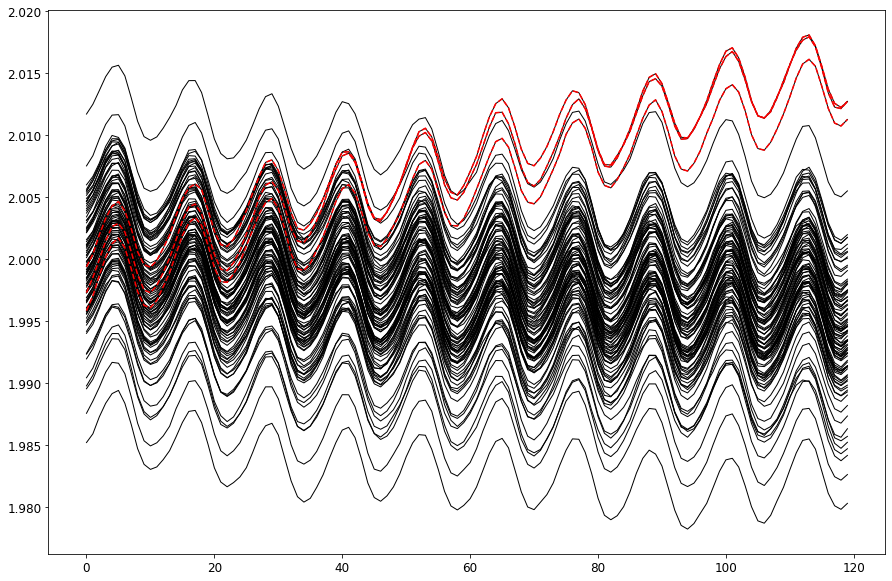

In [23]:
fcst = cftime.DatetimeJulian(2004, 11, 16)
mems = [40, 49, 52]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

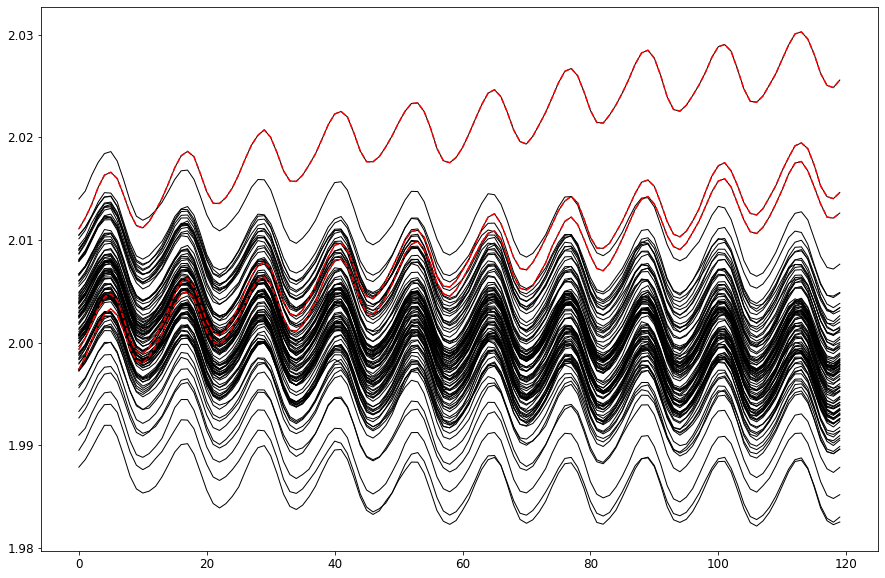

In [24]:
fcst = cftime.DatetimeJulian(2003, 11, 16)
mems = [2, 28, 70]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

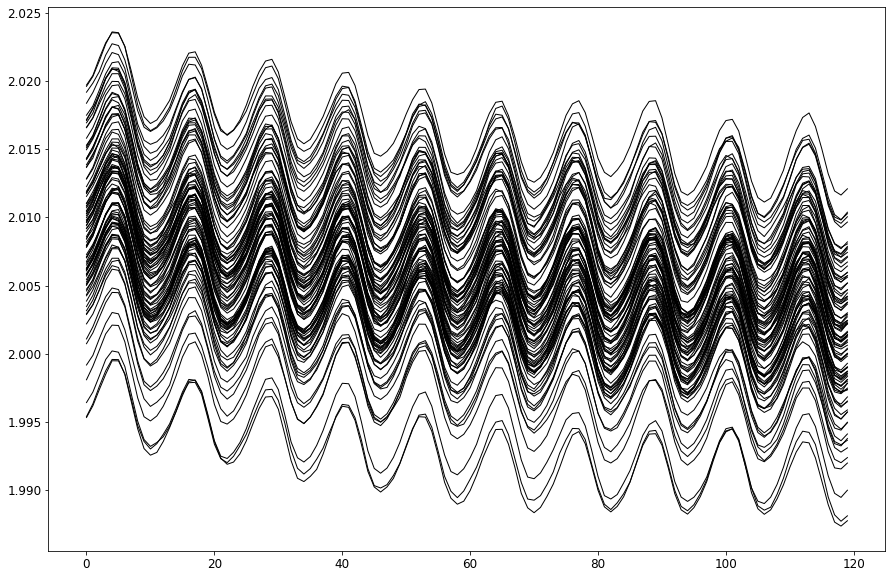

In [25]:
fcst = cftime.DatetimeJulian(2002, 11, 16)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

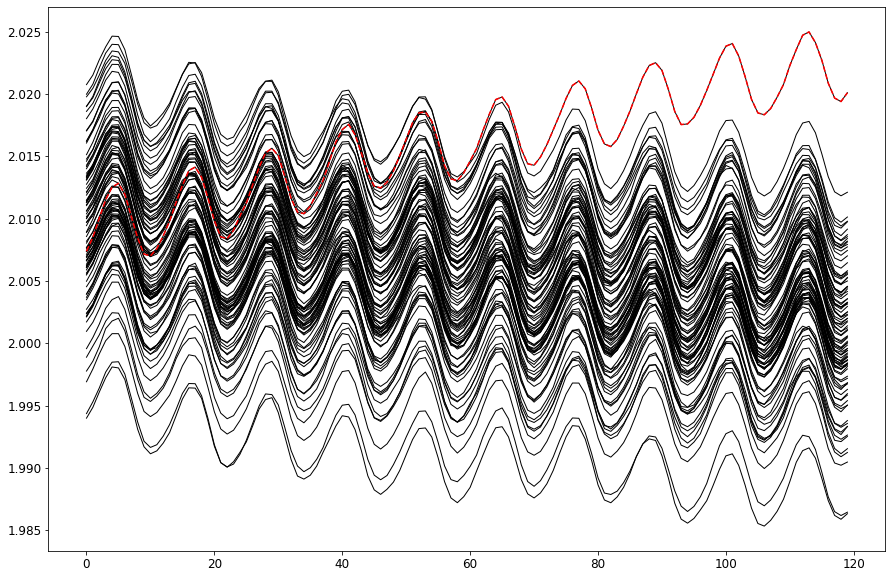

In [26]:
fcst = cftime.DatetimeJulian(2001, 11, 16)
mems = [90]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

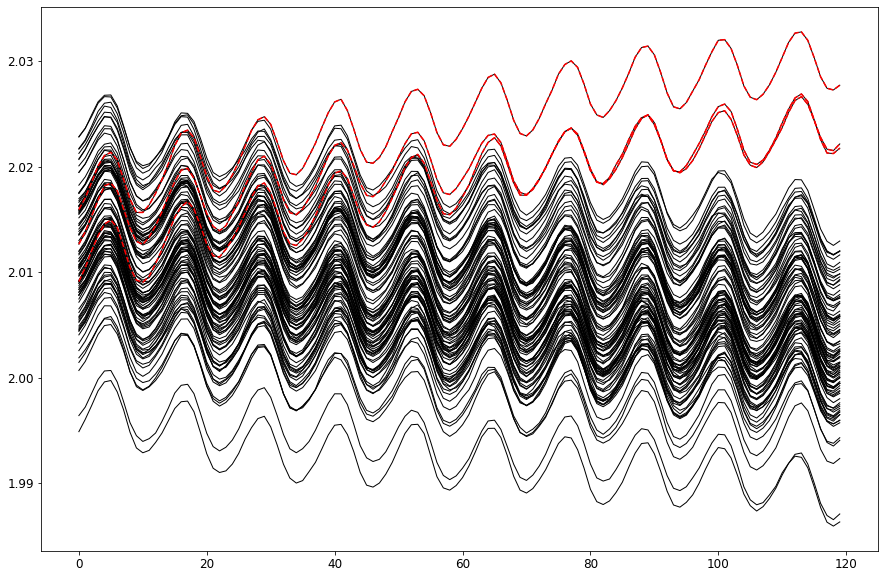

In [27]:
fcst = cftime.DatetimeJulian(2000, 11, 16)
mems = [21, 31, 36]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

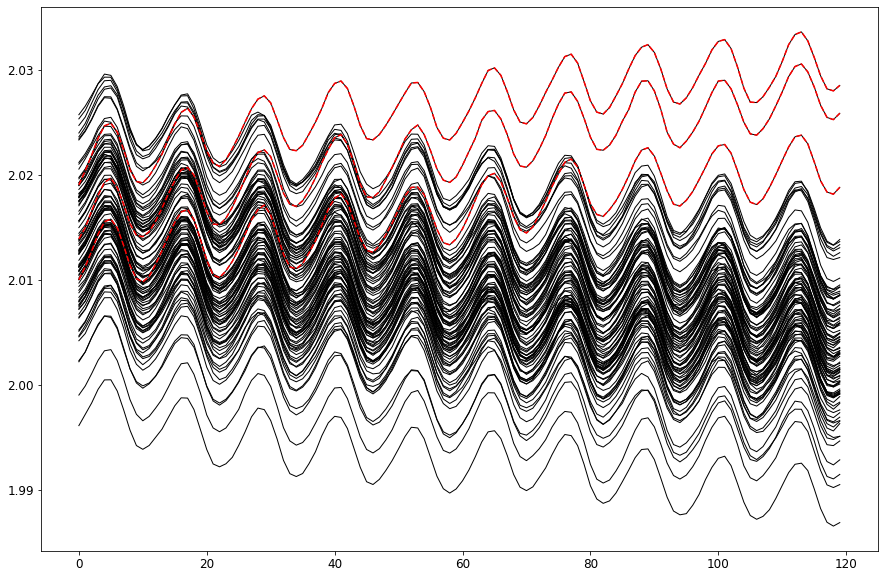

In [28]:
fcst = cftime.DatetimeJulian(1999, 11, 16)
mems = [5, 59, 95]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

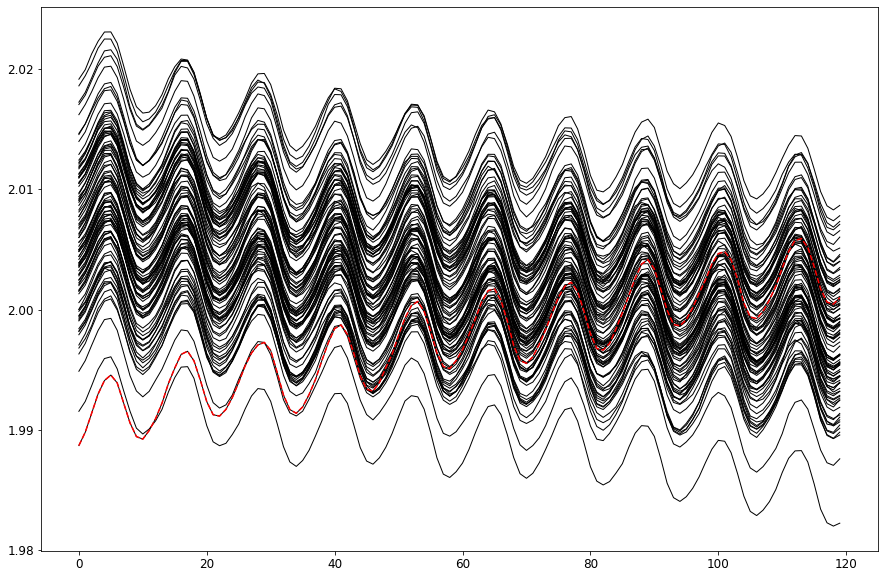

In [29]:
fcst = cftime.DatetimeJulian(1998, 11, 16)
mems = [85]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

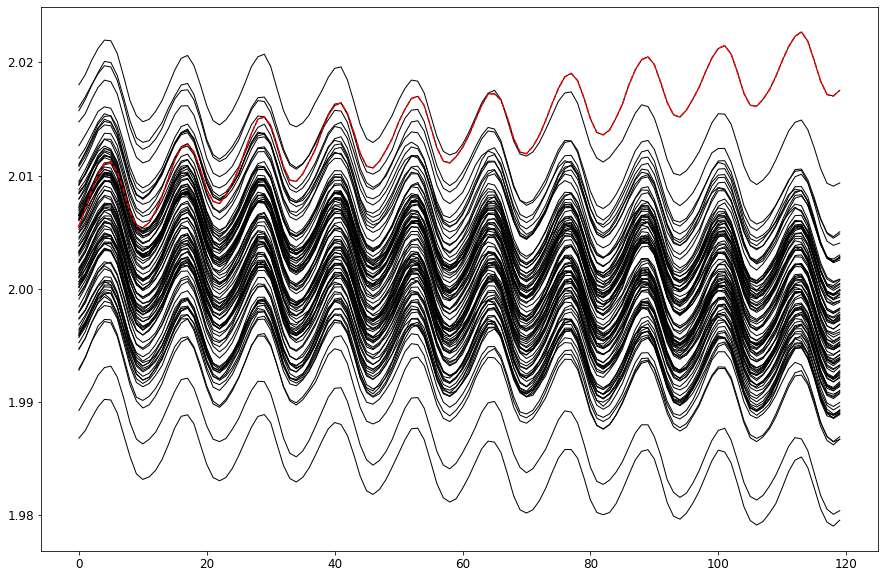

In [30]:
fcst = cftime.DatetimeJulian(1997, 11, 16)
mems = [88]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

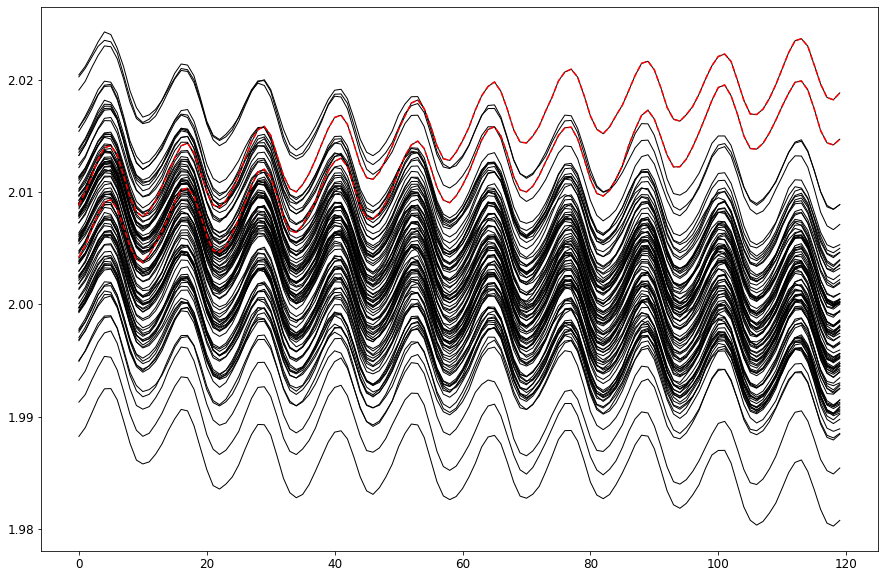

In [31]:
fcst = cftime.DatetimeJulian(1996, 11, 16)
mems = [16, 36]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

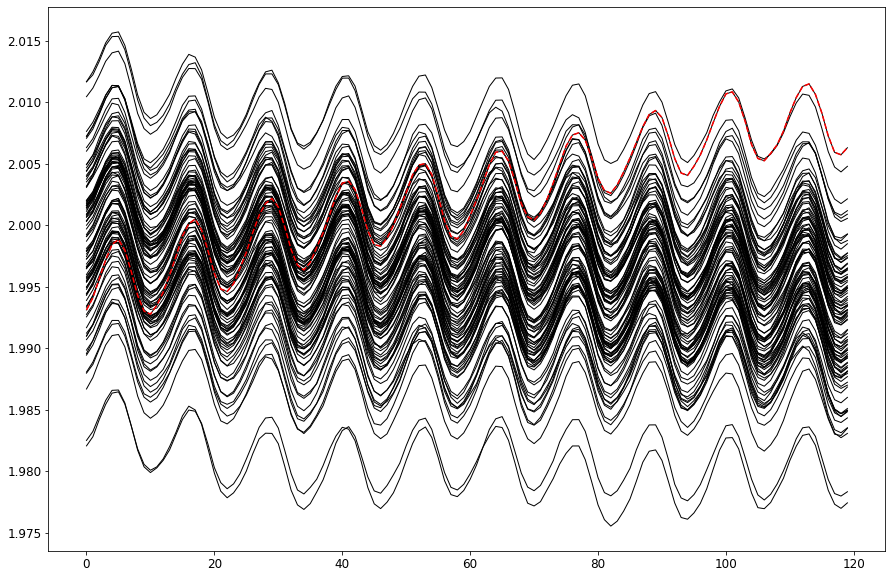

In [32]:
fcst = cftime.DatetimeJulian(1995, 11, 16)
mems = [7]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

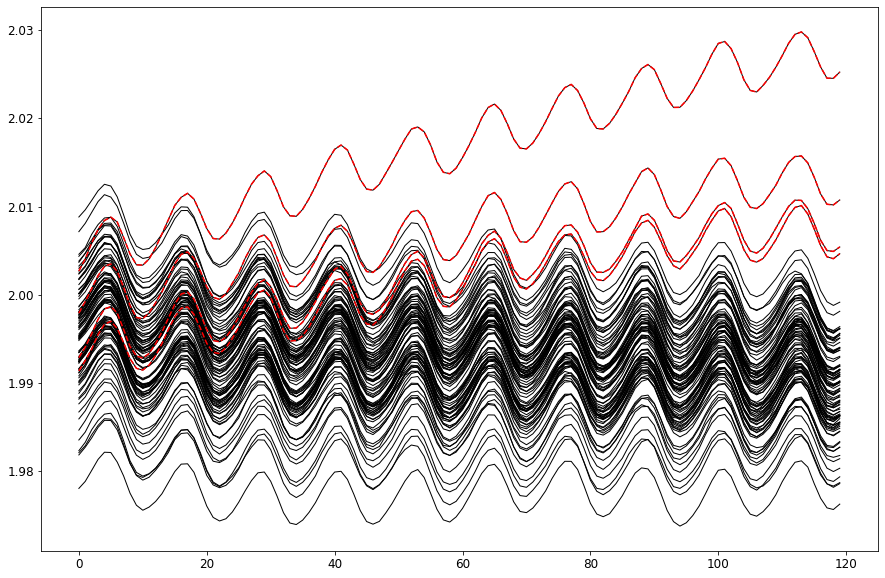

In [33]:
fcst = cftime.DatetimeJulian(1994, 11, 16)
mems = [3, 19, 69, 72]
tss = [1200, 1200, 1200, 900]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

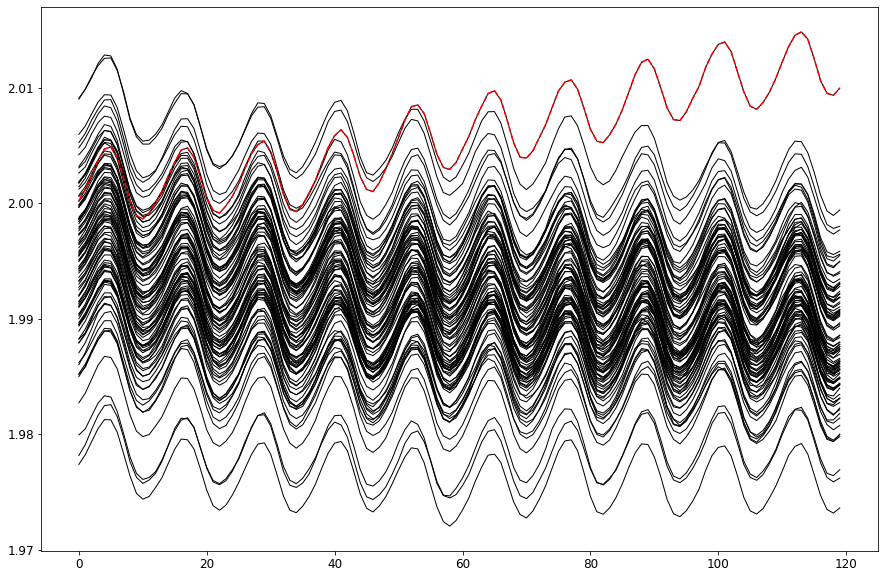

In [34]:
fcst = cftime.DatetimeJulian(1993, 11, 16)
mems = [53]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

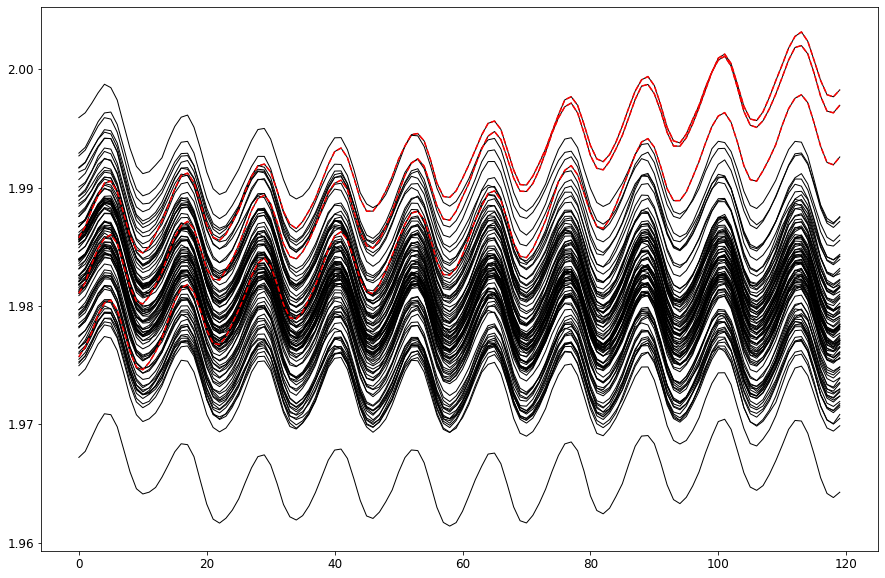

In [35]:
fcst = cftime.DatetimeJulian(1992, 11, 16)
mems = [44, 45, 76]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

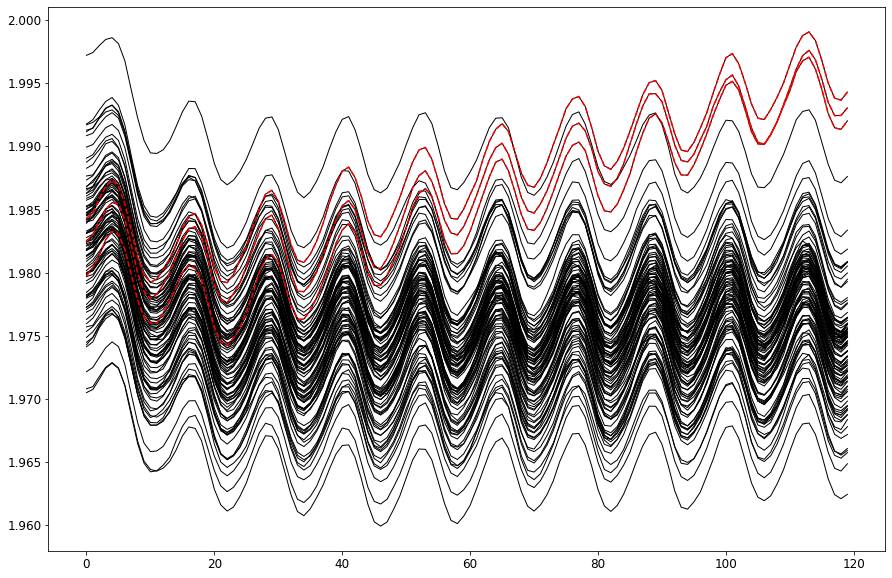

In [36]:
fcst = cftime.DatetimeJulian(1991, 11, 16)
mems = [24, 34, 40]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

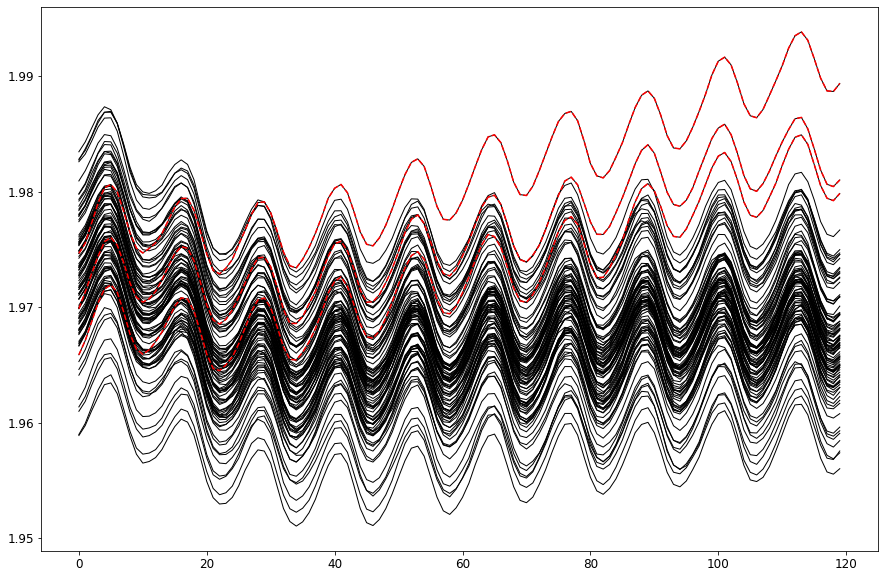

In [37]:
fcst = cftime.DatetimeJulian(1990, 11, 16)
mems = [32, 75, 90]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

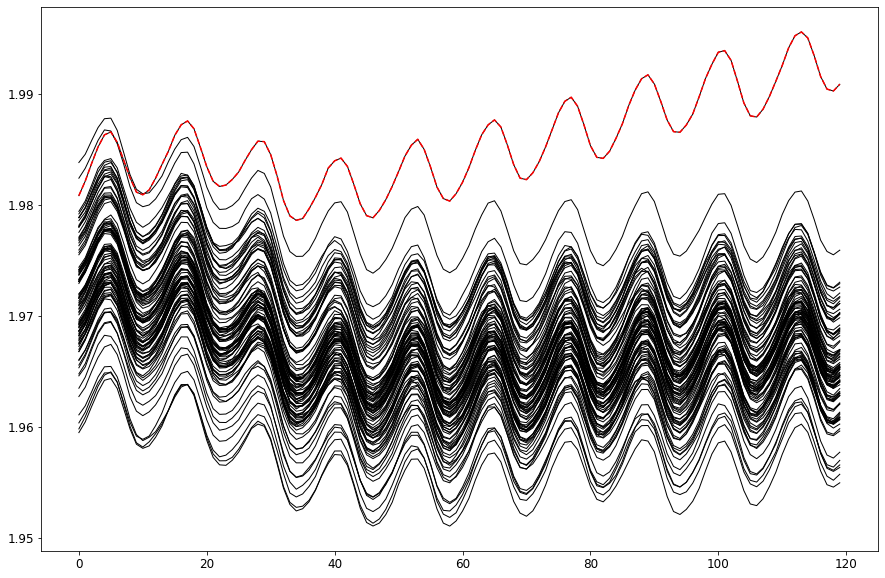

In [38]:
fcst = cftime.DatetimeJulian(1989, 11, 16)
mems = [29]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

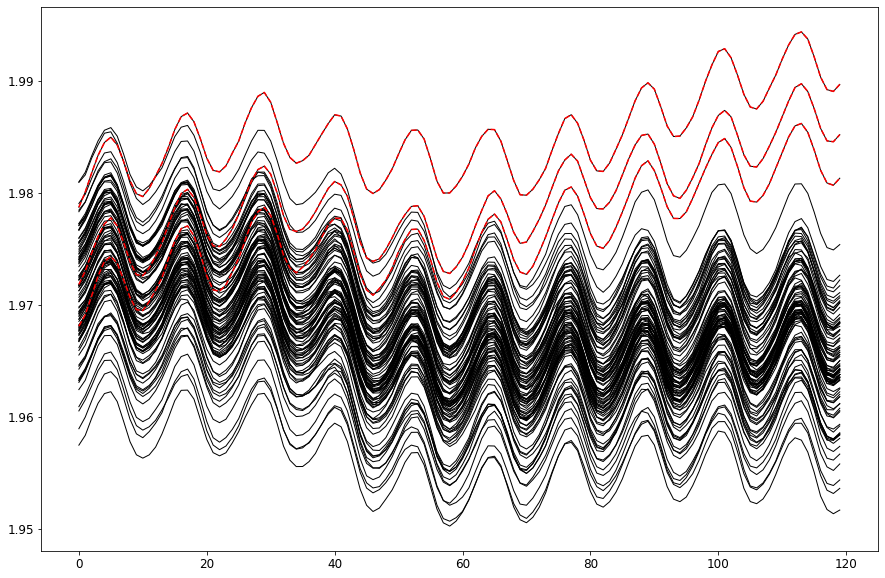

In [39]:
fcst = cftime.DatetimeJulian(1988, 11, 16)
mems = [2, 13, 69]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

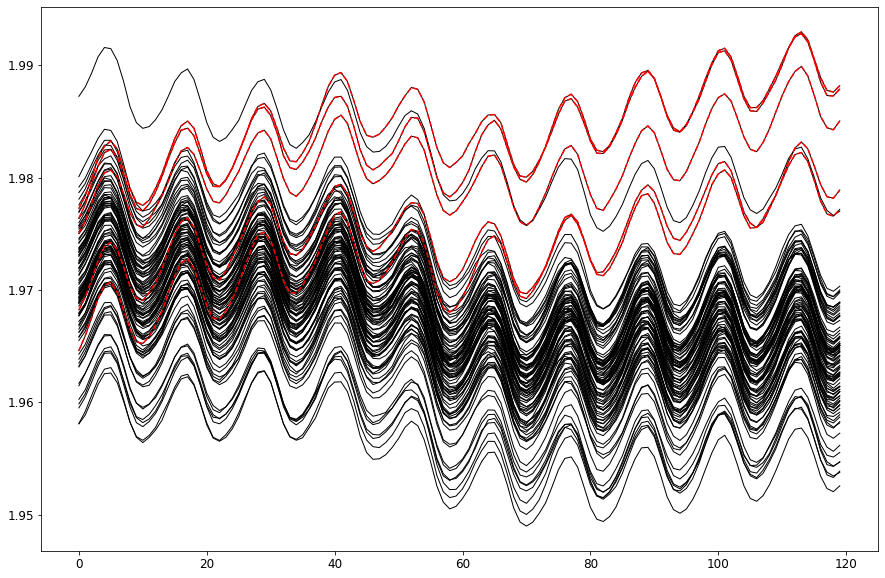

In [40]:
fcst = cftime.DatetimeJulian(1987, 11, 16)
mems = [20, 29, 65, 74, 89]
tss = [1200, 1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

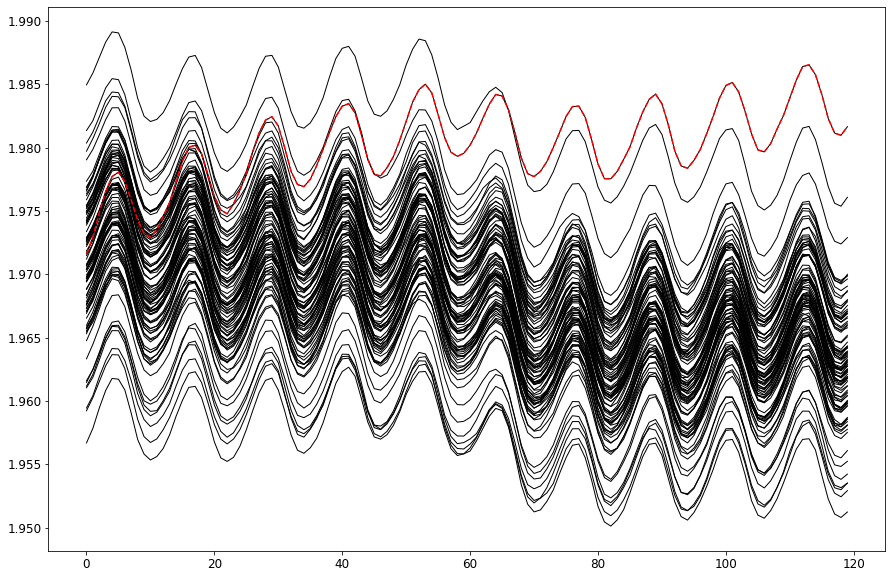

In [41]:
fcst = cftime.DatetimeJulian(1986, 11, 16)
mems = [79]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

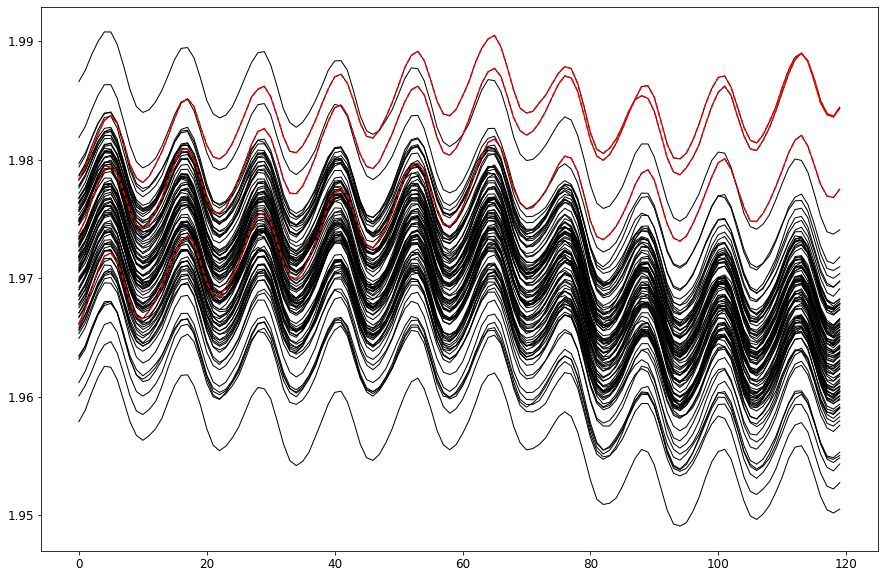

In [42]:
fcst = cftime.DatetimeJulian(1985, 11, 16)
mems = [1, 15, 87]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

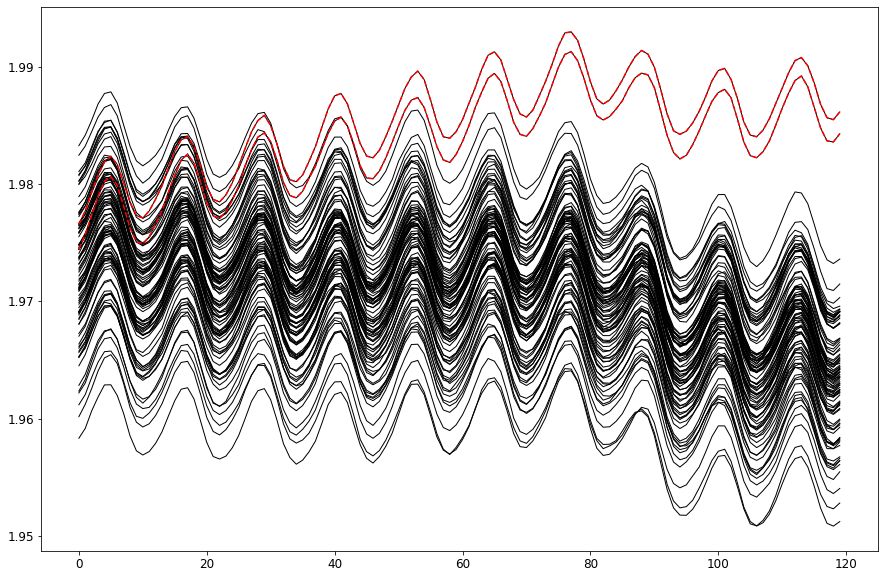

In [43]:
fcst = cftime.DatetimeJulian(1984, 11, 16)
mems = [53, 93]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

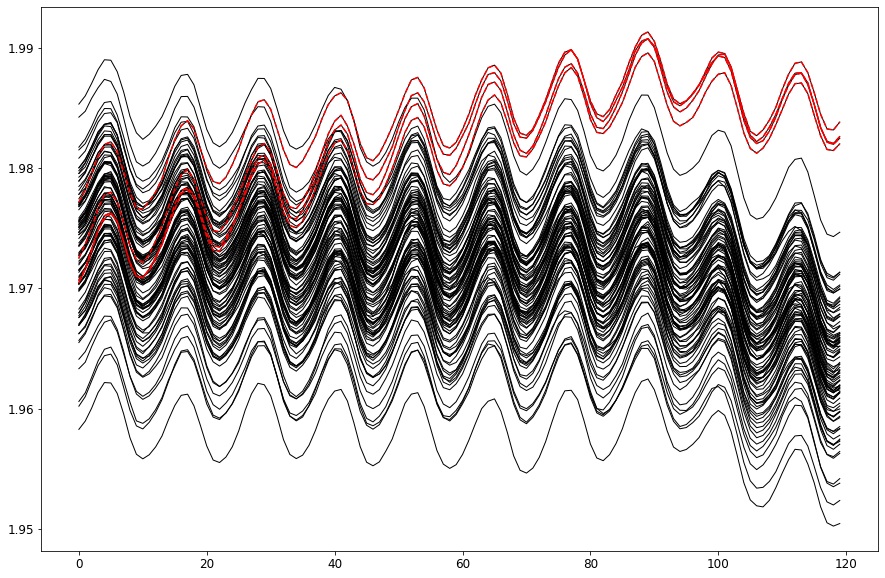

In [44]:
fcst = cftime.DatetimeJulian(1983, 11, 16)
mems = [16, 24, 46, 69]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

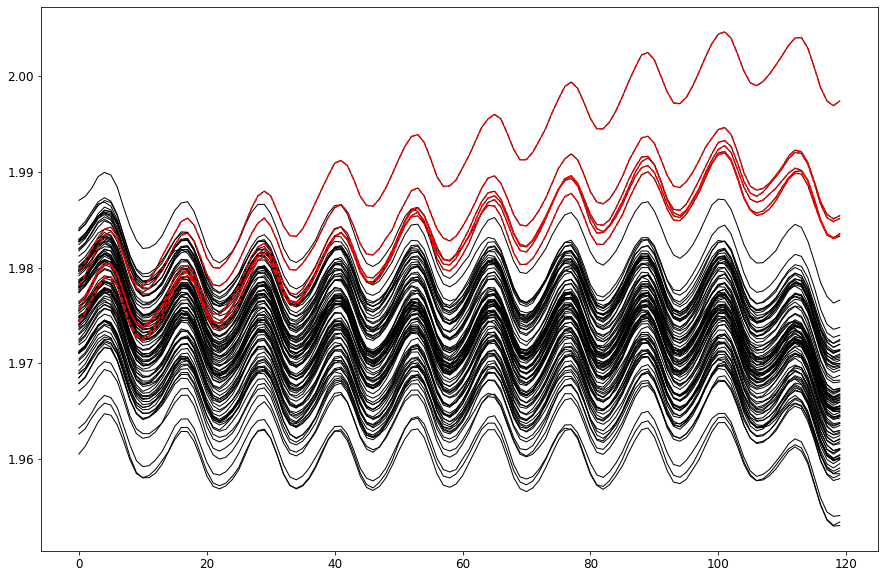

In [45]:
fcst = cftime.DatetimeJulian(1982, 11, 16)
mems = [4, 22, 44, 52, 64, 72]
tss = [1200, 1200, 1200, 1200, 900, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

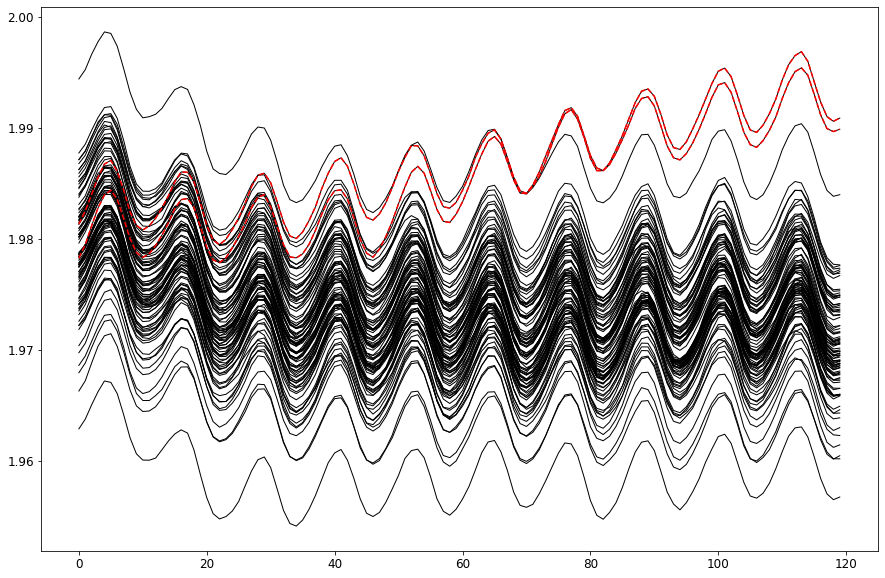

In [46]:
fcst = cftime.DatetimeJulian(1981, 11, 16)
mems = [23, 39]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

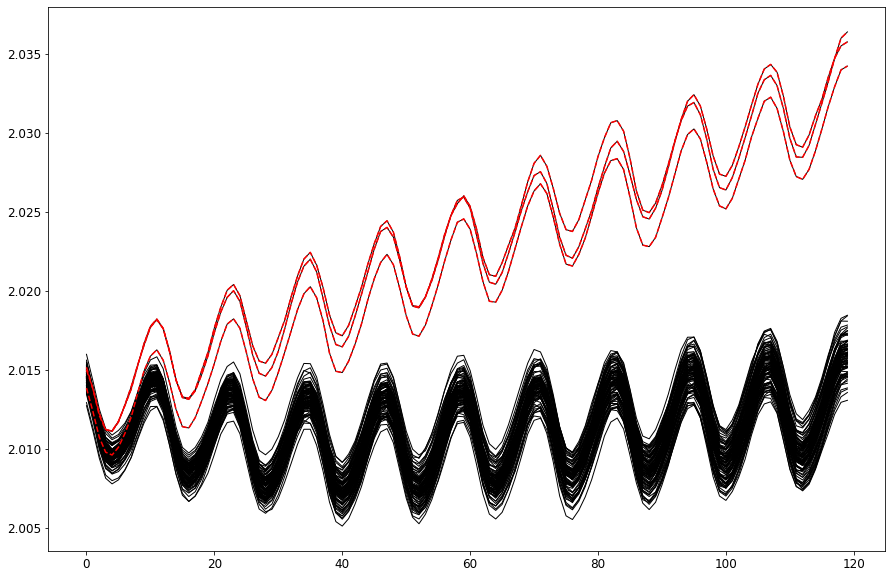

In [47]:
fcst = cftime.DatetimeJulian(2020, 5, 16, 12)
mems = [67, 71, 75]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

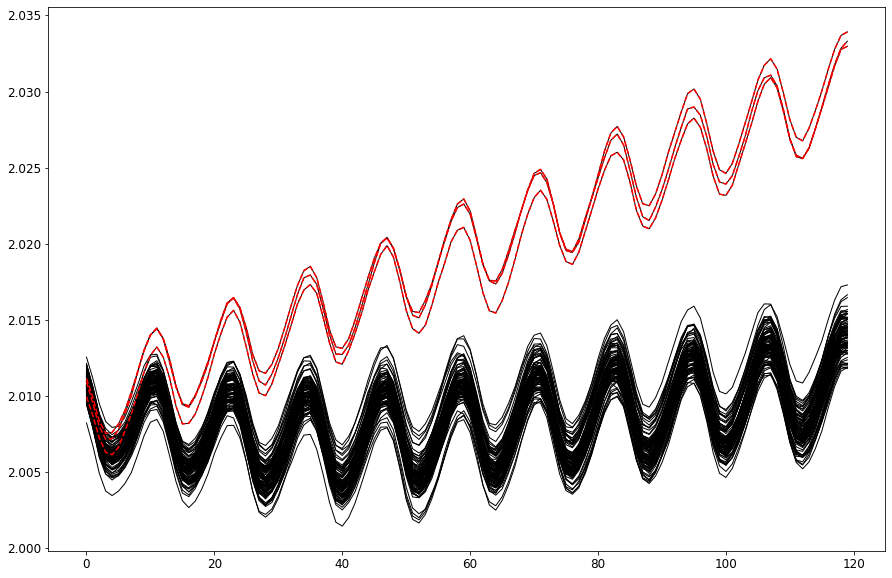

In [48]:
fcst = cftime.DatetimeJulian(2019, 5, 16, 12)
mems = [34, 53, 85]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

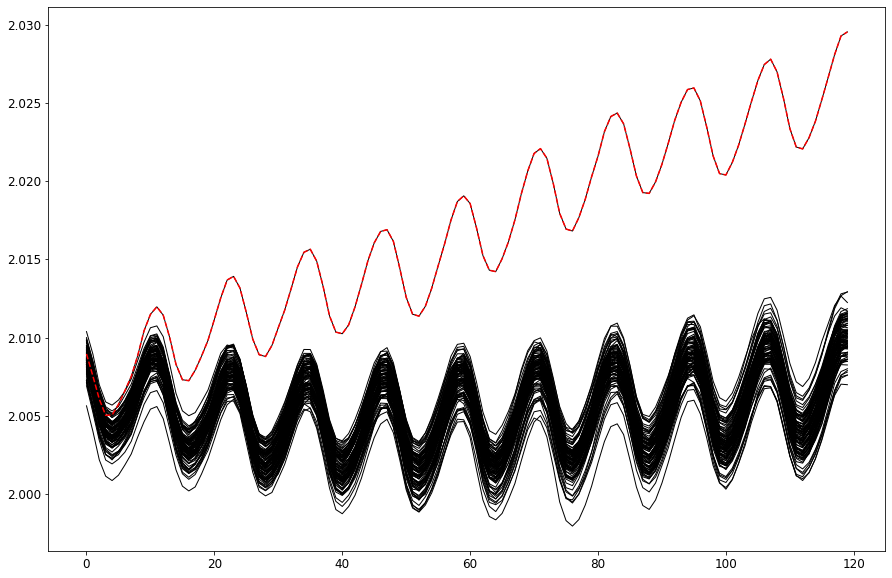

In [49]:
fcst = cftime.DatetimeJulian(2018, 5, 16, 12)
mems = [44]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

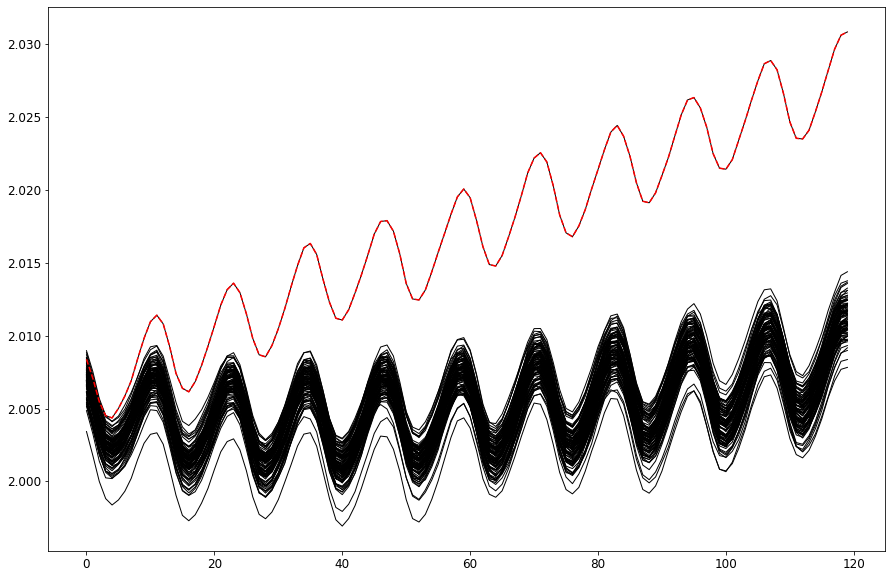

In [50]:
fcst = cftime.DatetimeJulian(2017, 5, 16, 12)
mems = [39]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

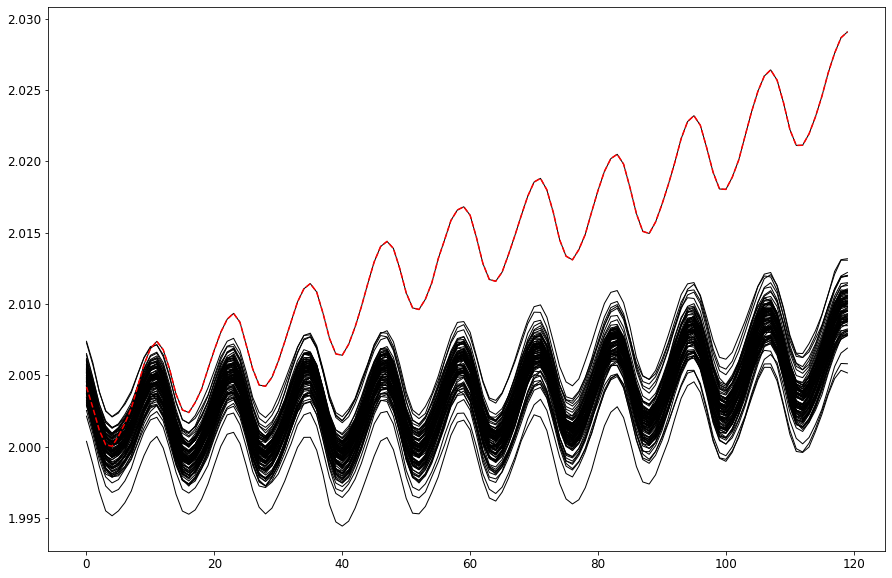

In [51]:
fcst = cftime.DatetimeJulian(2016, 5, 16, 12)
mems = [47]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

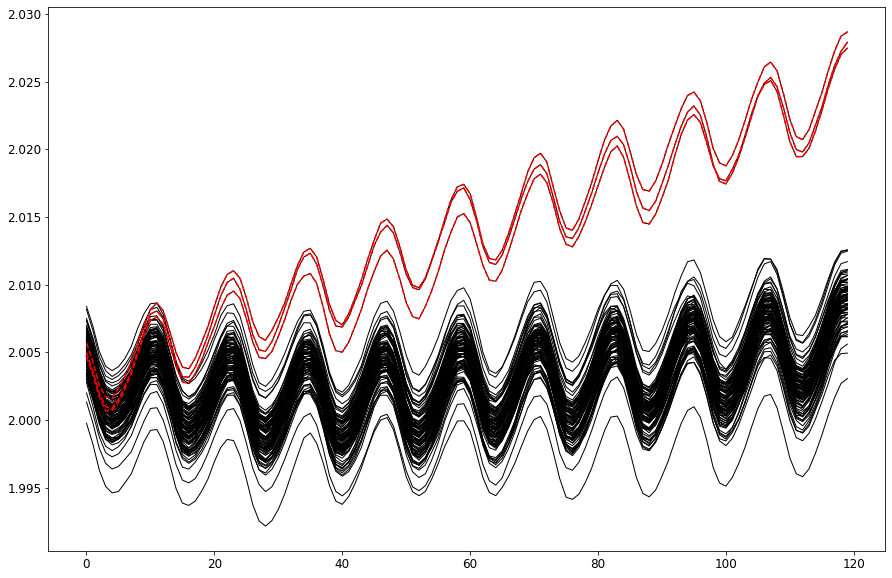

In [52]:
fcst = cftime.DatetimeJulian(2015, 5, 16, 12)
mems = [18, 49, 64]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

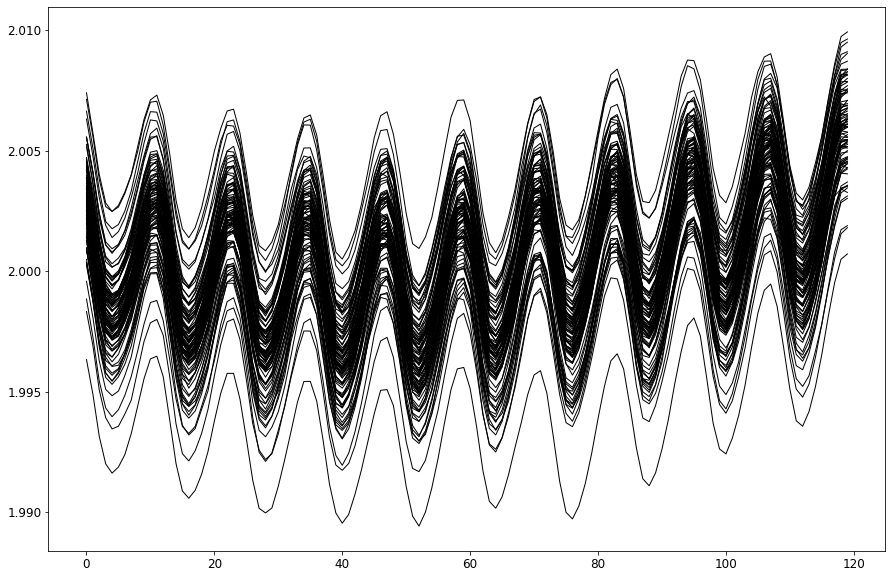

In [53]:
fcst = cftime.DatetimeJulian(2014, 5, 16, 12)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

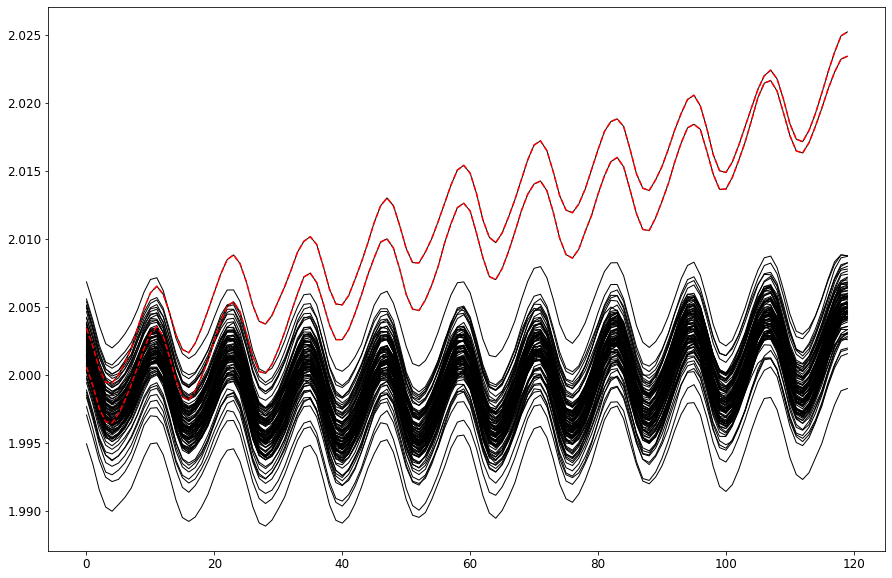

In [54]:
fcst = cftime.DatetimeJulian(2013, 5, 16, 12)
mems = [34, 49]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

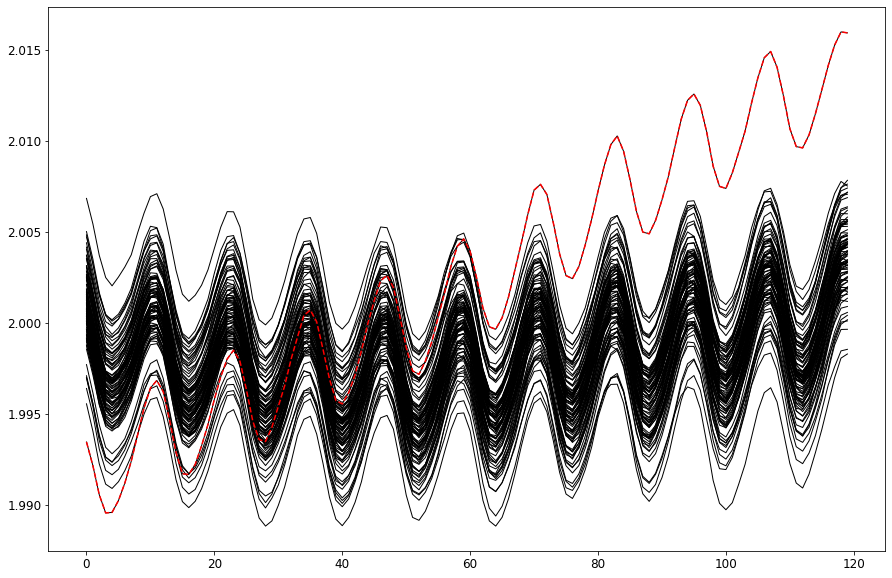

In [55]:
fcst = cftime.DatetimeJulian(2012, 5, 16, 12)
mems = [96]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

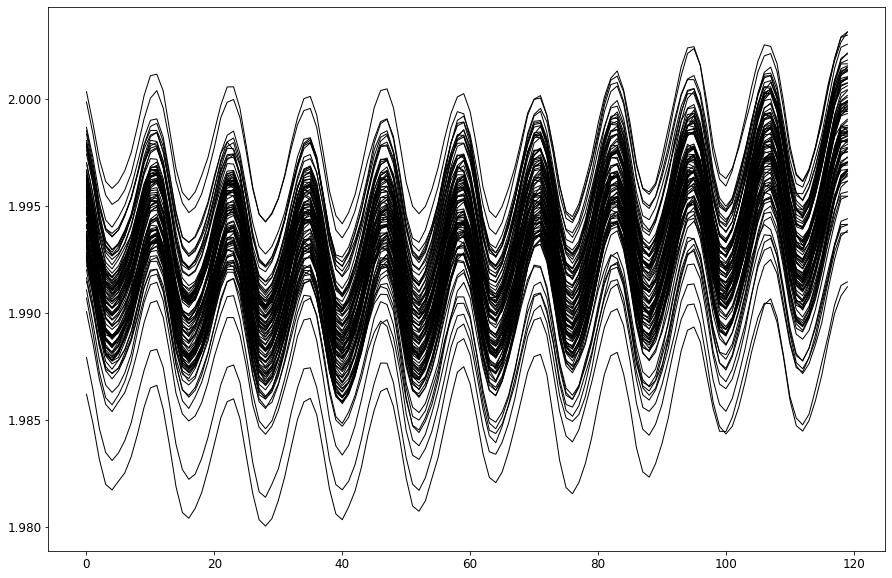

In [56]:
fcst = cftime.DatetimeJulian(2011, 5, 16, 12)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

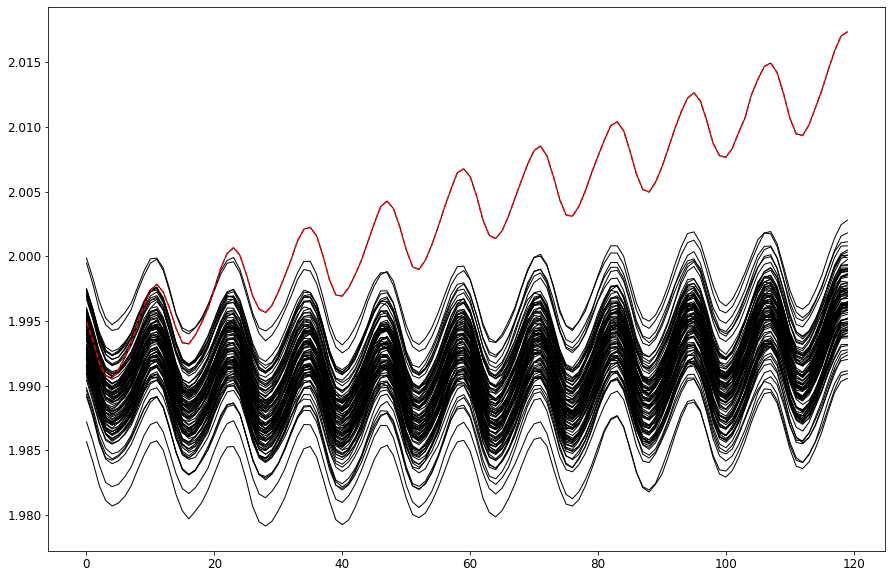

In [57]:
fcst = cftime.DatetimeJulian(2010, 5, 16, 12)
mems = [48]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

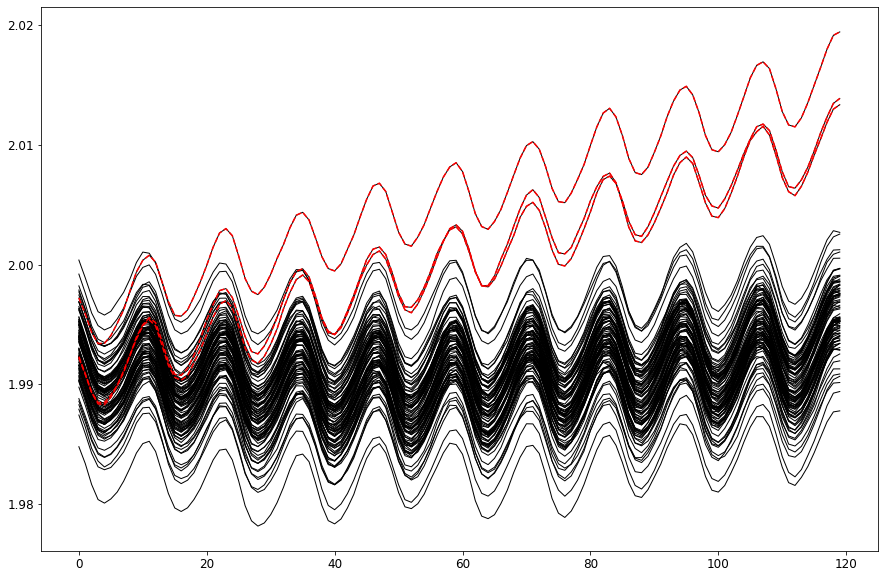

In [58]:
fcst = cftime.DatetimeJulian(2009, 5, 16, 12)
mems = [1, 37, 95]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

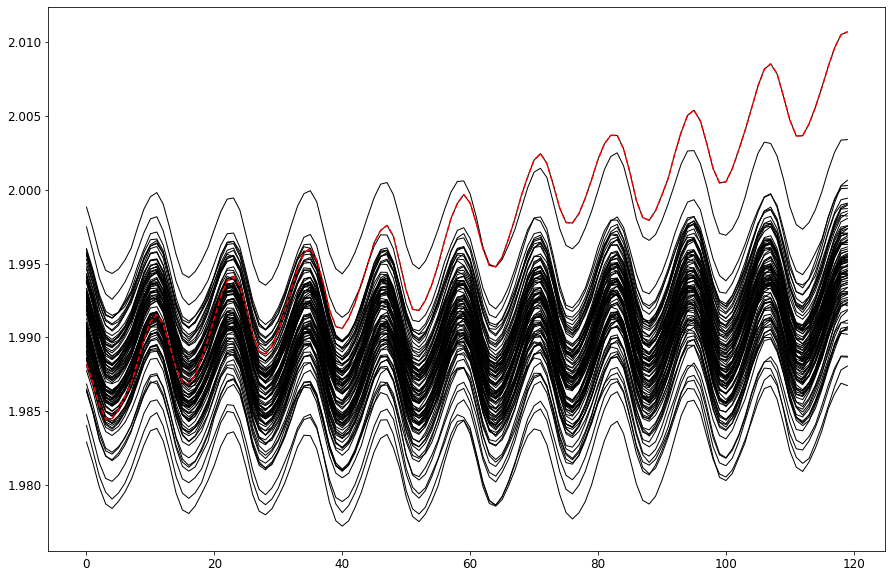

In [59]:
fcst = cftime.DatetimeJulian(2008, 5, 16, 12)
mems = [17]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

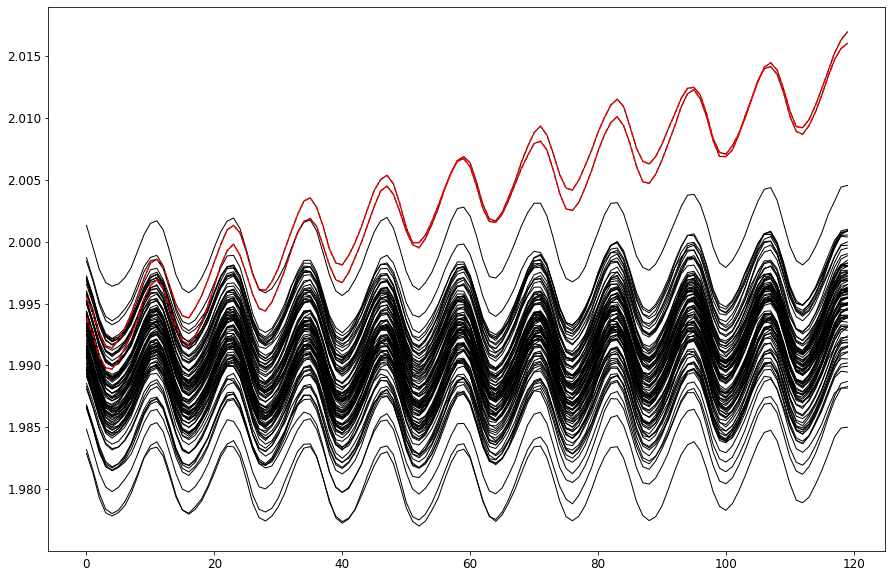

In [60]:
fcst = cftime.DatetimeJulian(2007, 5, 16, 12)
mems = [18, 40]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

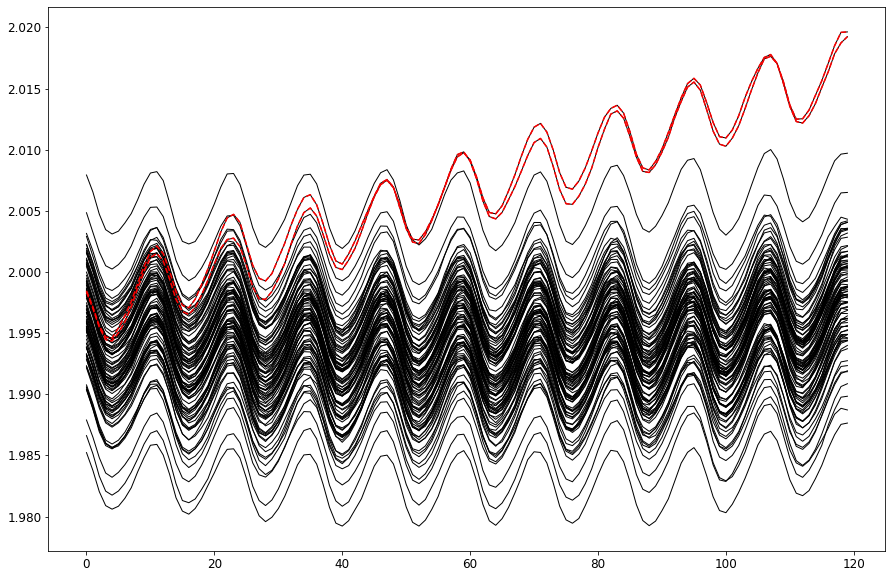

In [61]:
fcst = cftime.DatetimeJulian(2006, 5, 16, 12)
mems = [32, 74]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

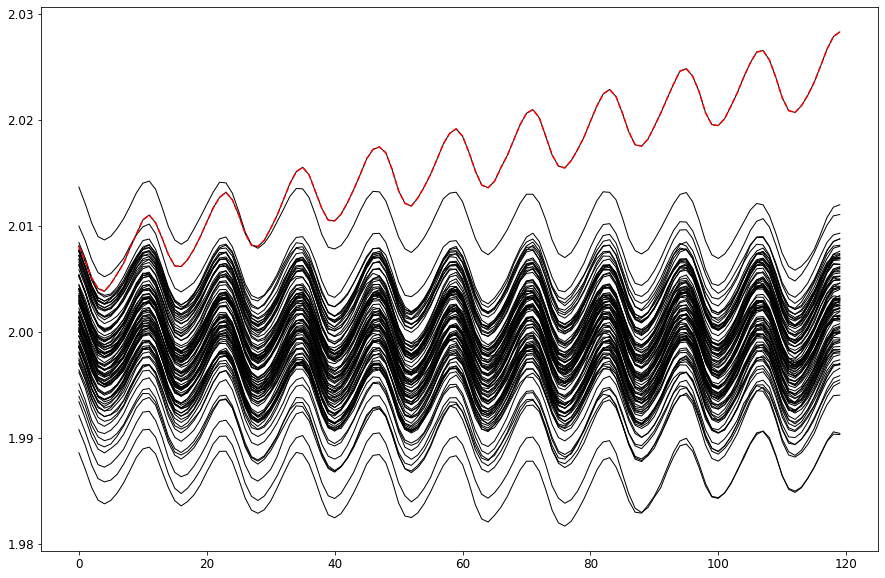

In [62]:
fcst = cftime.DatetimeJulian(2005, 5, 16, 12)
mems = [50]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

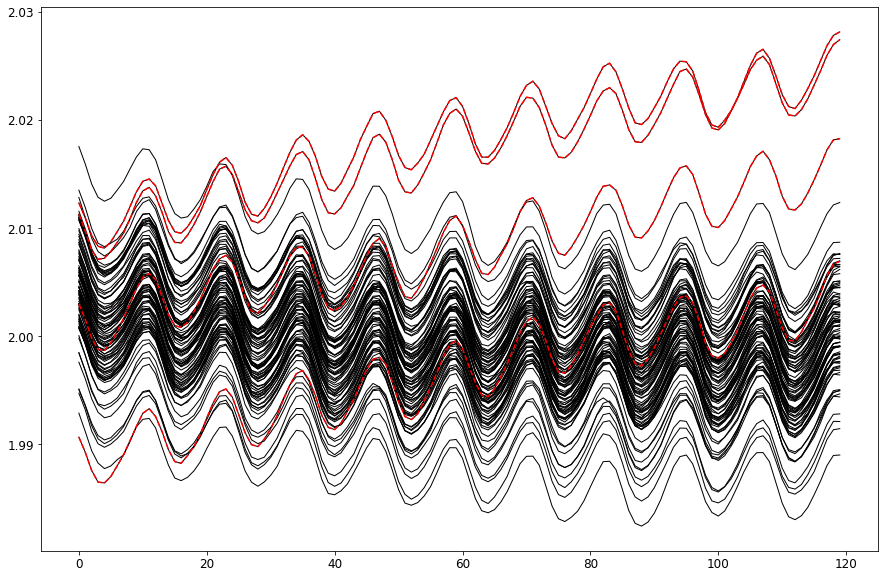

In [63]:
fcst = cftime.DatetimeJulian(2004, 5, 16, 12)
mems = [7, 46, 50, 82]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

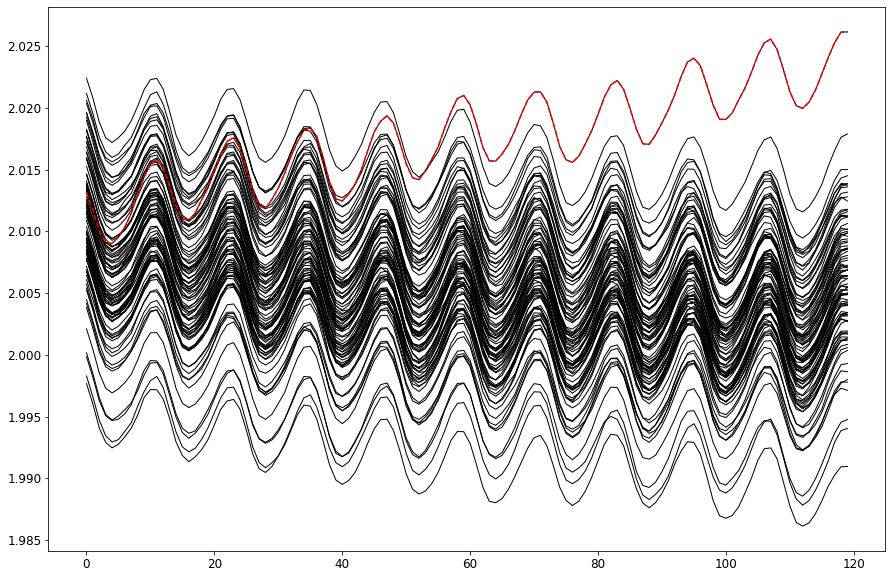

In [64]:
fcst = cftime.DatetimeJulian(2003, 5, 16, 12)
mems = [63]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

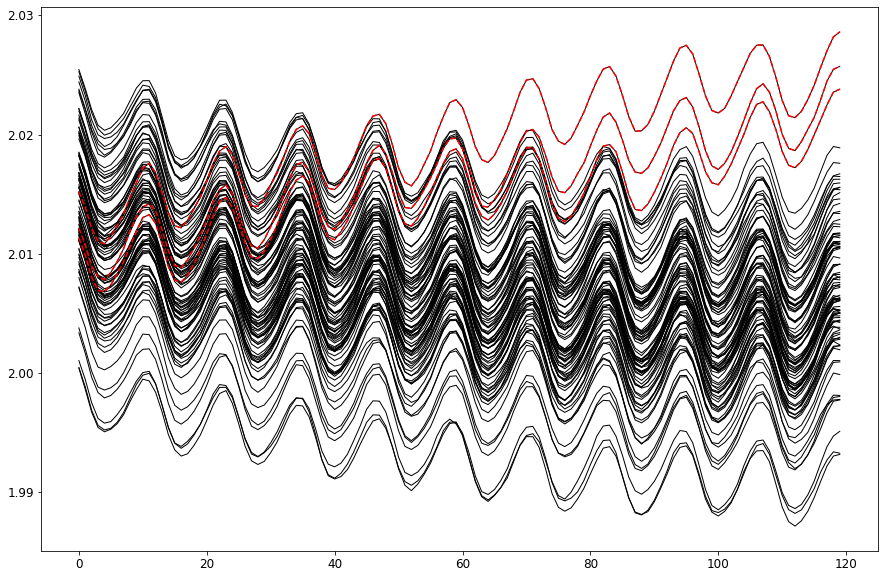

In [65]:
fcst = cftime.DatetimeJulian(2002, 5, 16, 12)
mems = [12, 42, 90]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

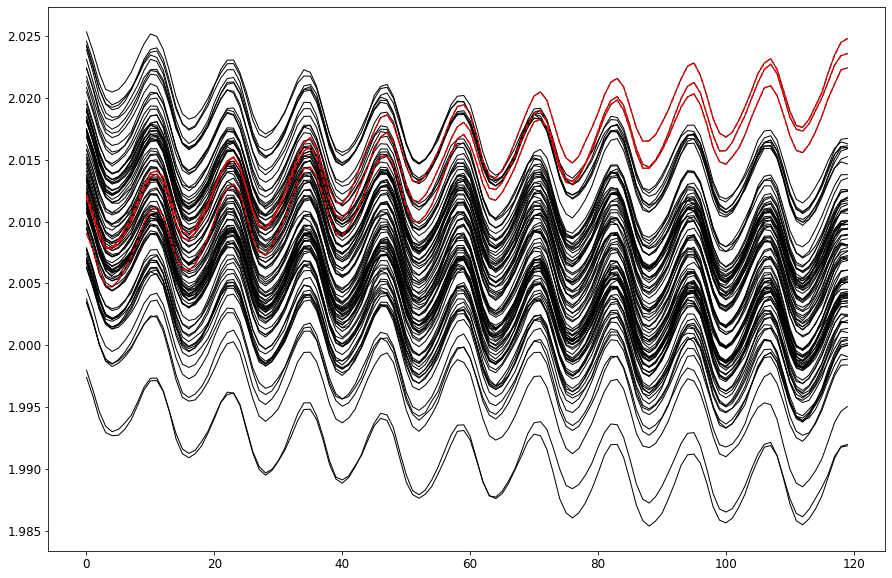

In [66]:
fcst = cftime.DatetimeJulian(2001, 5, 16, 12)
mems = [16, 61, 87]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

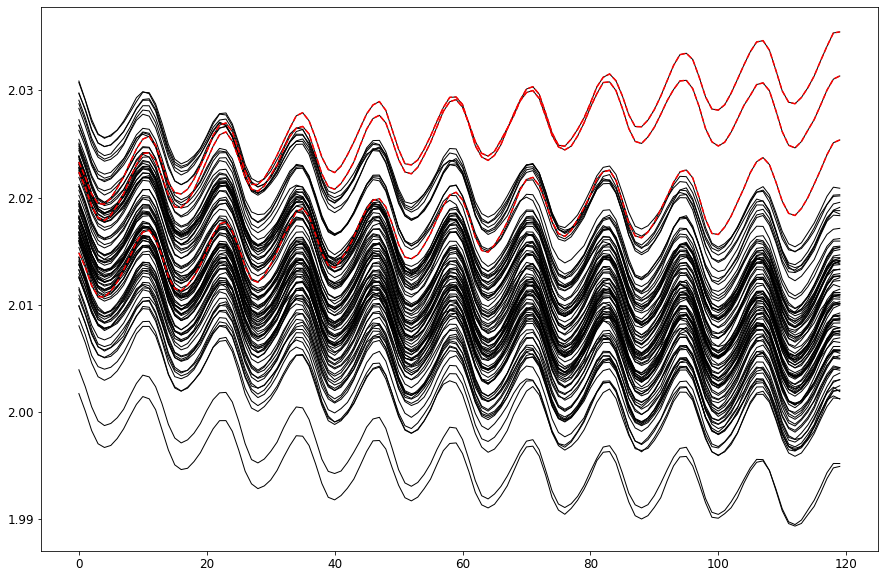

In [67]:
fcst = cftime.DatetimeJulian(2000, 5, 16, 12)
mems = [17, 75, 88]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

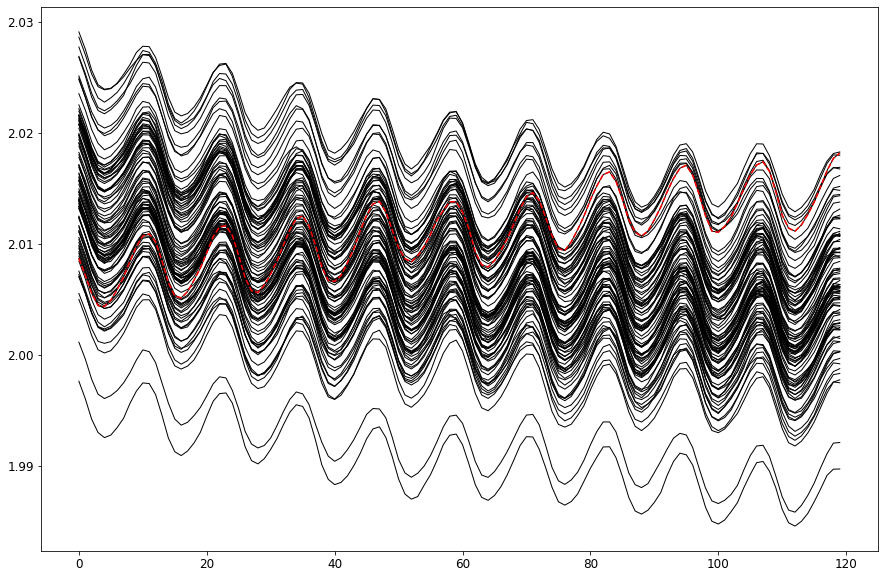

In [68]:
fcst = cftime.DatetimeJulian(1999, 5, 16, 12)
mems = [56]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

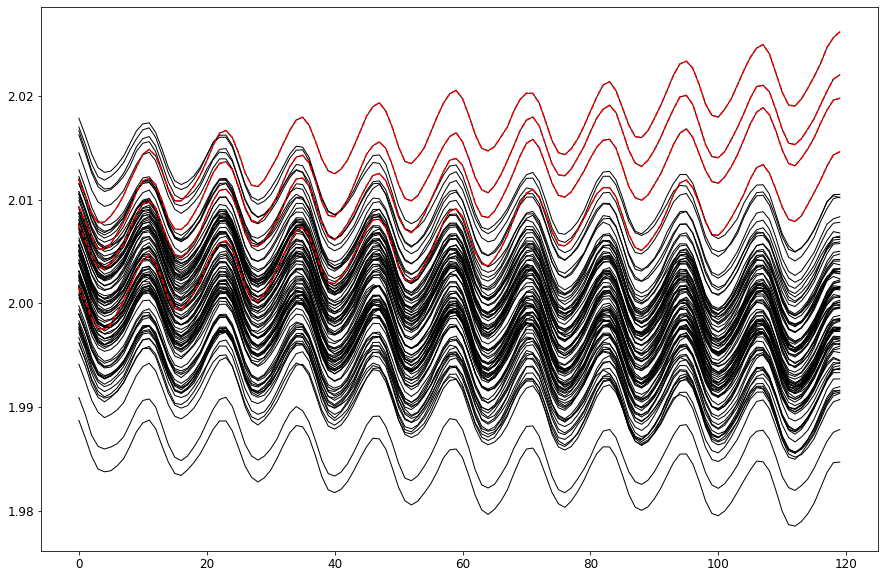

In [69]:
fcst = cftime.DatetimeJulian(1998, 5, 16, 12)
mems = [21, 54, 59, 92]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

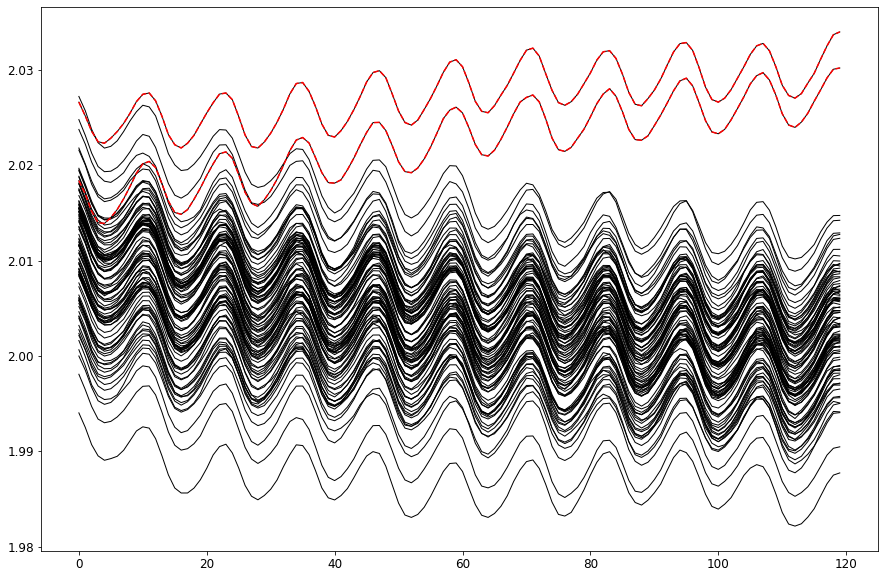

In [70]:
fcst = cftime.DatetimeJulian(1997, 5, 16, 12)
mems = [39, 77]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

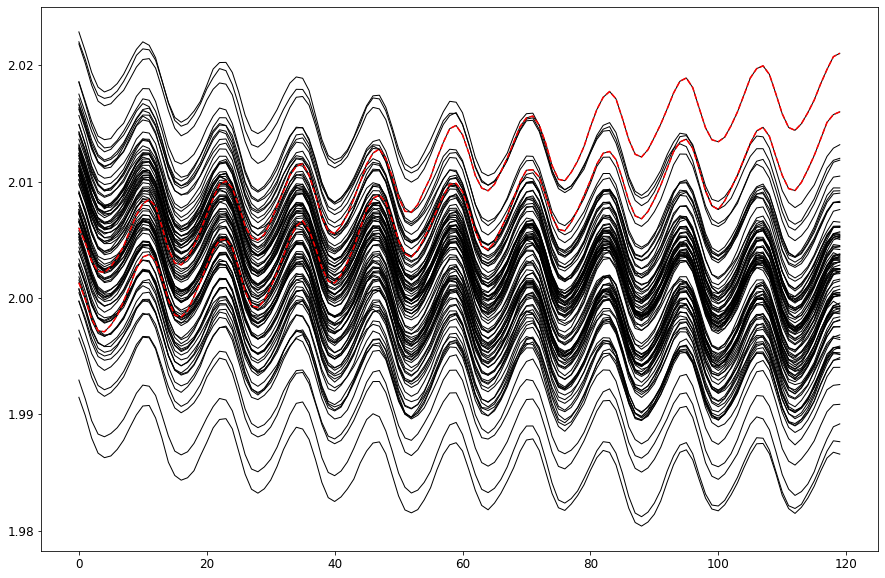

In [71]:
fcst = cftime.DatetimeJulian(1996, 5, 16, 12)
mems = [22, 38]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

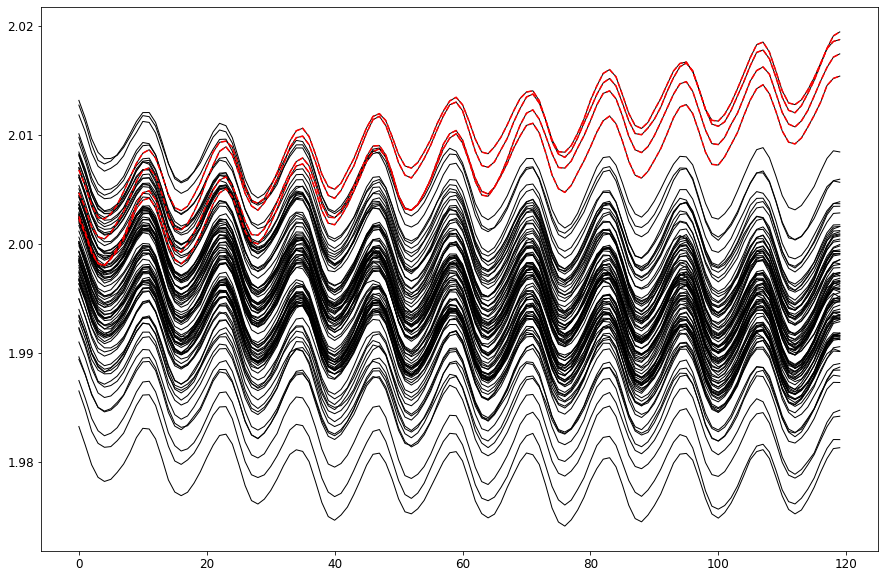

In [72]:
fcst = cftime.DatetimeJulian(1995, 5, 16, 12)
mems = [19, 45, 54, 62]
tss = [1200, 1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

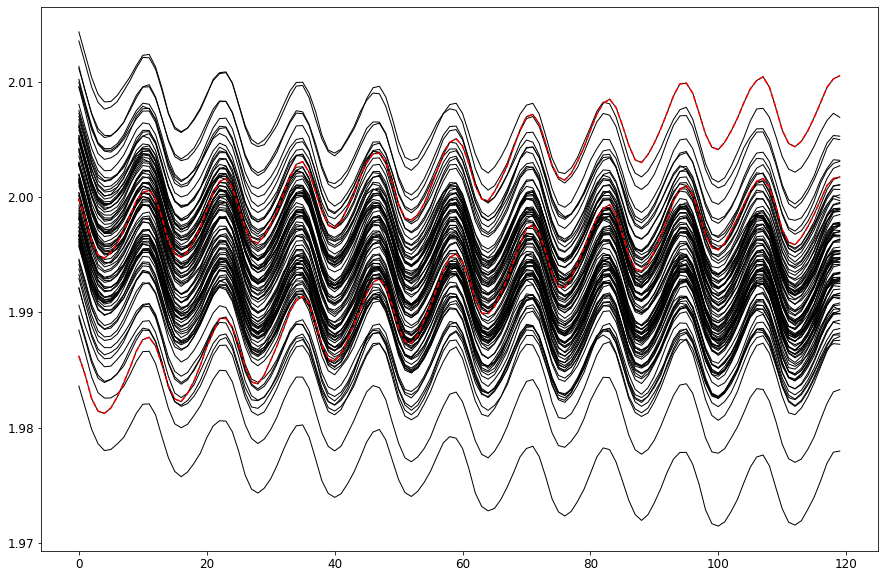

In [73]:
fcst = cftime.DatetimeJulian(1994, 5, 16, 12)
mems = [27, 41]
tss = [1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

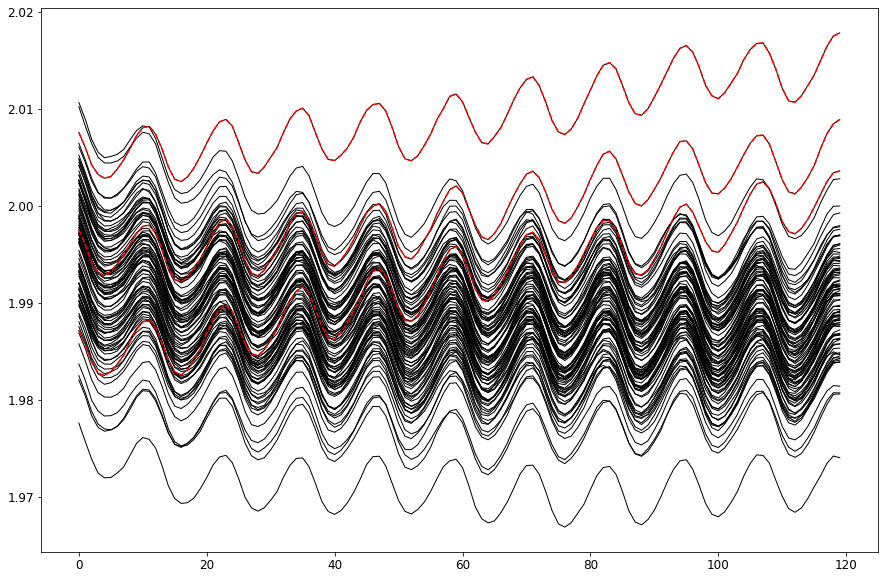

In [74]:
fcst = cftime.DatetimeJulian(1993, 5, 16, 12)
mems = [2, 29, 63]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

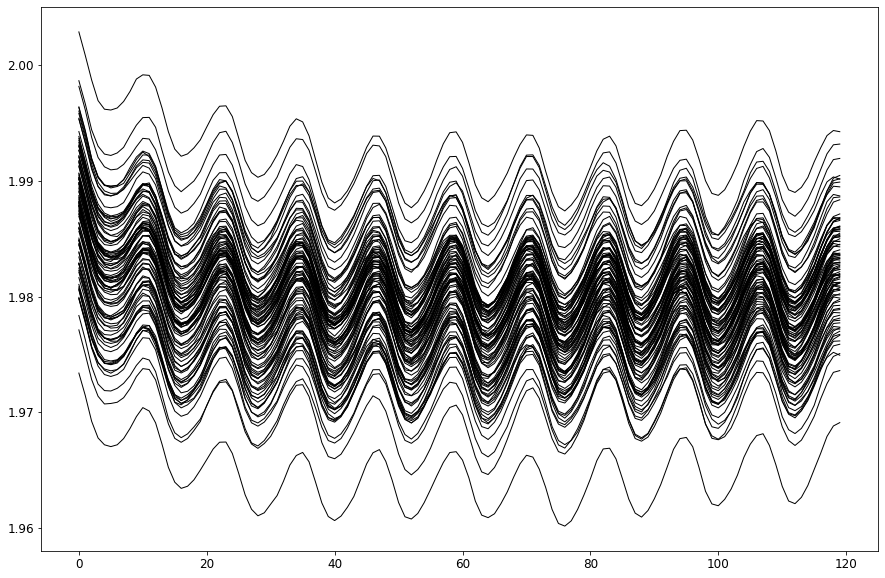

In [75]:
fcst = cftime.DatetimeJulian(1992, 5, 16, 12)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

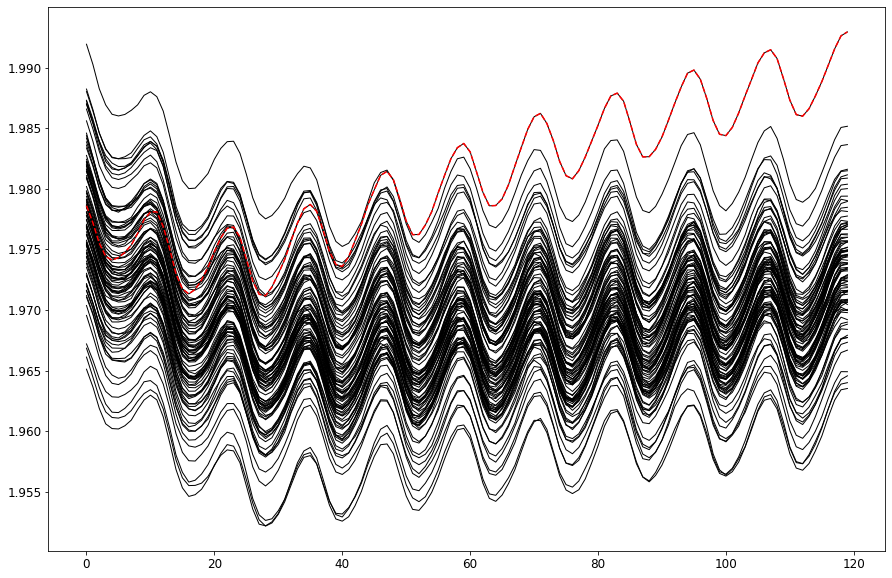

In [76]:
fcst = cftime.DatetimeJulian(1991, 5, 16, 12)
mems = [21]
tss = [1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

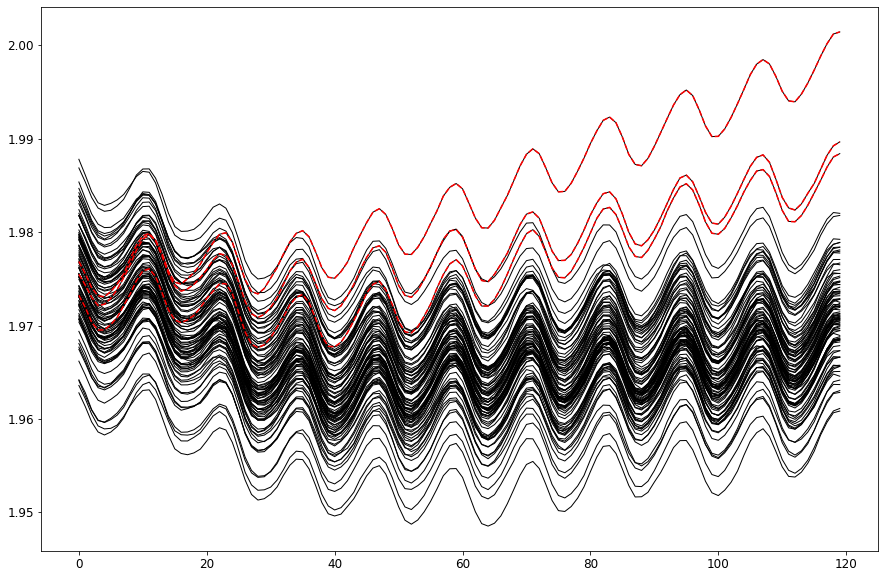

In [77]:
fcst = cftime.DatetimeJulian(1990, 5, 16, 12)
mems = [14, 36, 55]
tss = [900, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

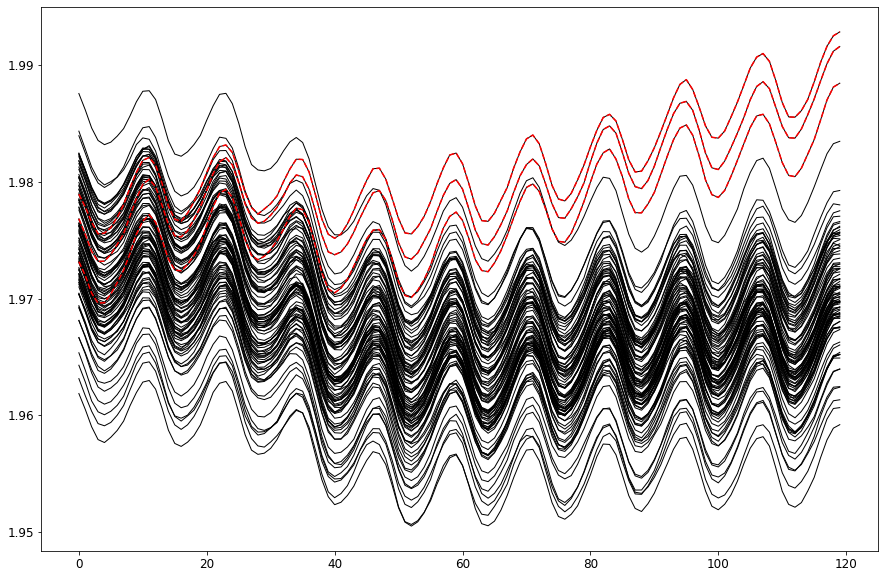

In [78]:
fcst = cftime.DatetimeJulian(1989, 5, 16, 12)
mems = [31, 49, 71]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

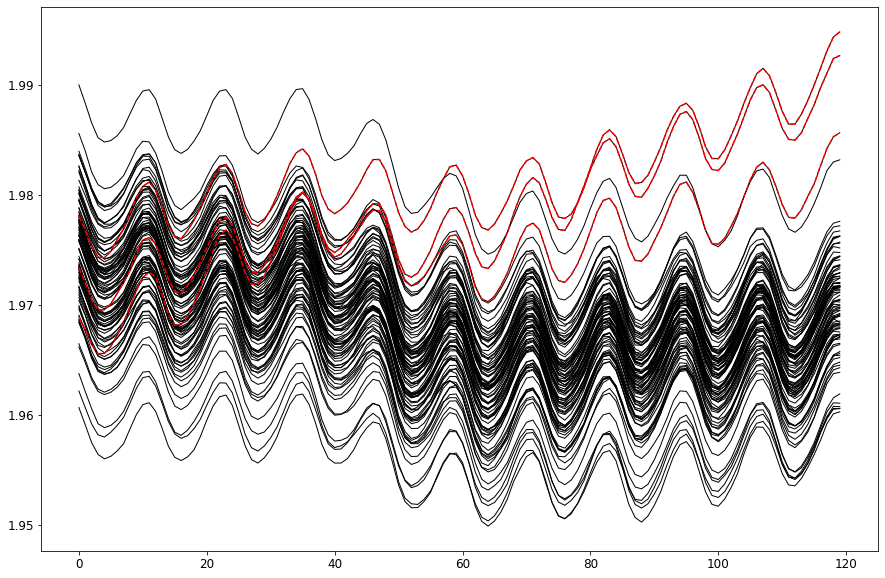

In [79]:
fcst = cftime.DatetimeJulian(1988, 5, 16, 12)
mems = [14, 80, 94]
tss = [1200, 1200, 900]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

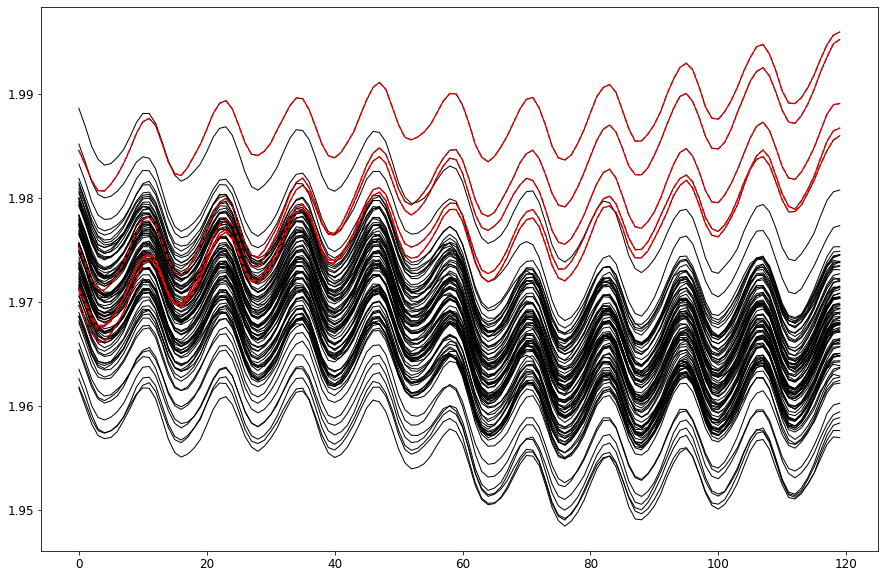

In [80]:
fcst = cftime.DatetimeJulian(1987, 5, 16, 12)
mems = [22, 37, 46, 50, 61]
tss = [1200, 1200, 1200, 1200, 900]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

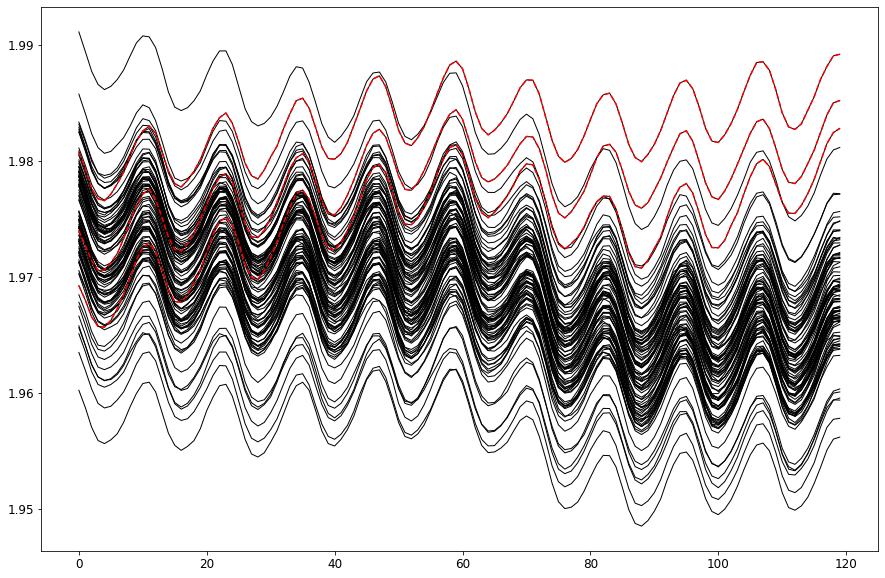

In [81]:
fcst = cftime.DatetimeJulian(1986, 5, 16, 12)
mems = [2, 48, 52]
tss = [1200, 1200, 1200]

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

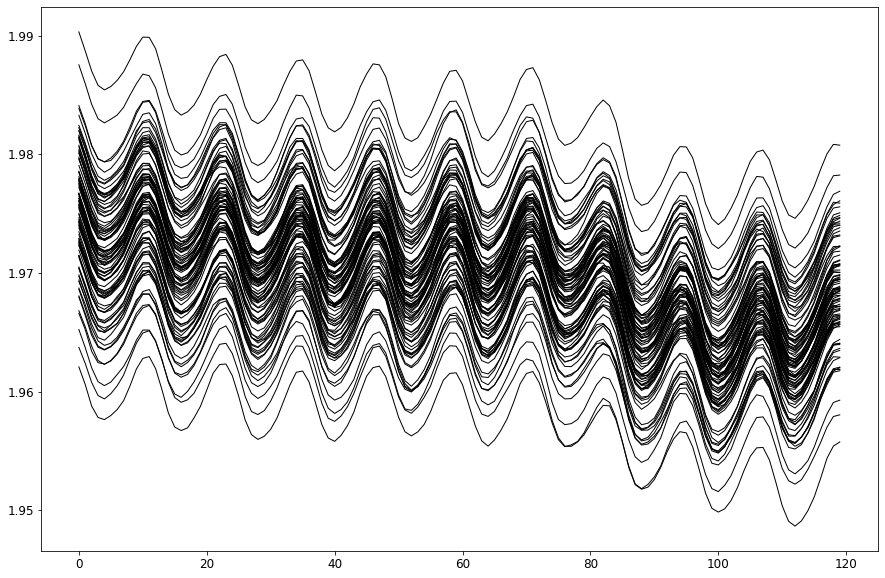

In [82]:
fcst = cftime.DatetimeJulian(1985, 5, 16, 12)
mems = []
tss = []

template = update_template(template, fcst, mems, tss)
plot_forecast(heat, fcst, mems, tss)

# Some stats

In [83]:
reduced = xr.where(template<1800, 1, 0)

In [84]:
reduced.mean() * 100

<xarray.DataArray ()>
array(2.39857456)

In [85]:
reduced.sum()

<xarray.DataArray ()>
array(175)

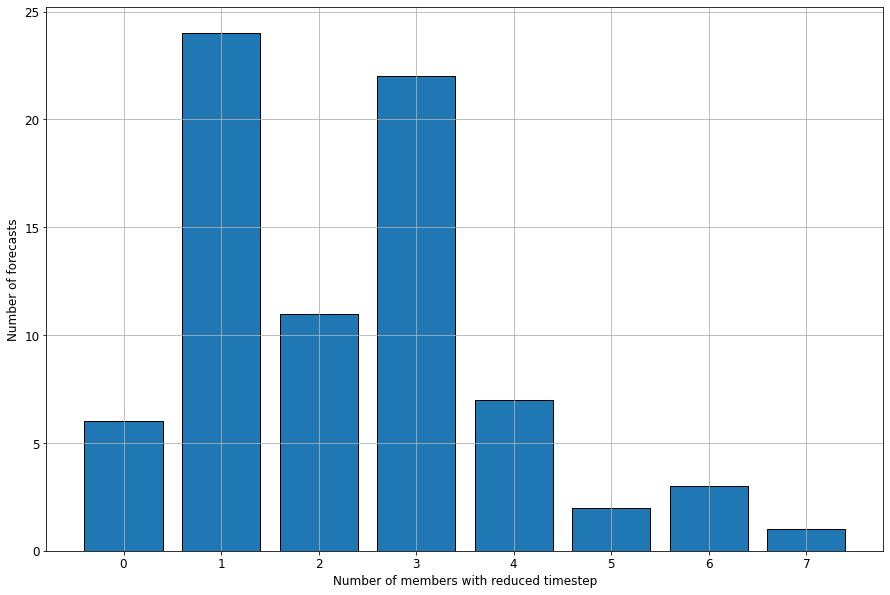

In [86]:
plt.hist(reduced.sum('ensemble'), bins=np.arange(-0.5,8.5,1), rwidth=0.8, edgecolor='k')
plt.ylabel('Number of forecasts');
plt.xlabel('Number of members with reduced timestep');
plt.grid()

# Save a mask

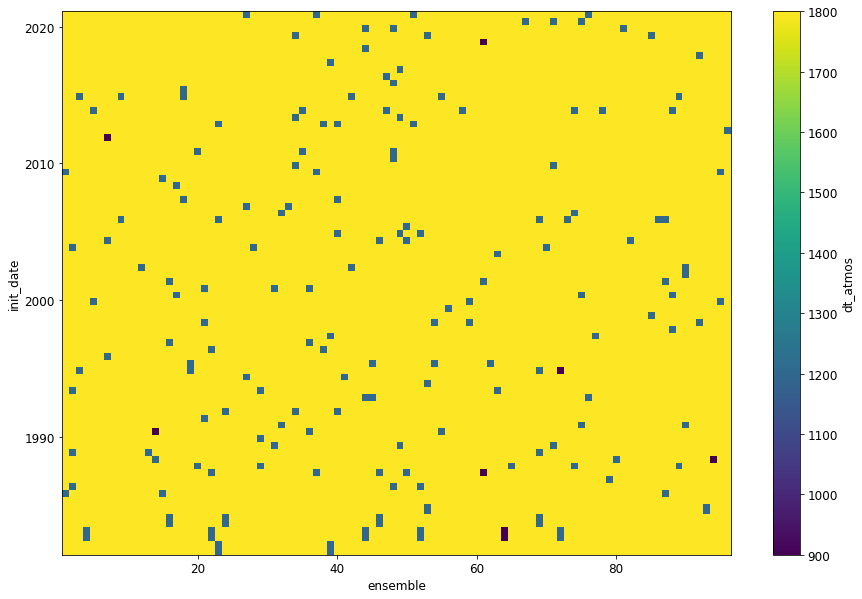

In [88]:
template = template.rename('dt_atmos')
template.plot()

In [89]:
template.attrs['Summary'] = 'The atmospheric time step (dt_atmos) used for each run of the CAFE-f6 forecast dataset'

In [ ]:
template.to_netcdf('/g/data/xv83/dcfp/CAFE-f6/CAFE-f6_dt_atmos.nc')